<a href="https://github.com/a-garcia13/Proyecto-Ciencia-de-datos-Aplicada/raw/main/Primera_entrega_Proyecto_Ciencia_de_Datos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Tercera Entrega

Miembros del proyecto:

*   Alejandro Garcia Flores
*   Brayann Quevedo
*   Fabian Castellanos


### 6. Entendimiento los datos / producto: 
Generar un reporte de análisis
exploratorio de las fuentes de datos. Validar las hipótesis iniciales.

#### 6.1 Preguntas/Hipotesis a contestar:
-	¿Cuáles son las carreras o facultades que utilizan más cupos en convenios generales?
-	¿Cuáles son las carreras o facultades que más convenios específicos tienen y cuál es su tasa de utilización de cupos específicos?
-	¿Cuáles son las 30 universidades que más postulaciones de pregrado reciben?
-	¿Cuál es el porcentaje de estudiantes de pregrado que se postulan a las 30 universidades con más postulaciones?
-	¿Cuáles son las universidades con menos cupos utilizados?
-	¿Qué características comparten las universidades con menos cupos utilizados y más cupos utilizados?

#### 6.2 Analisis exploratorio:

*   Inicializar librerias

In [ ]:
!pip install keras-tuner

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 135 kB 5.3 MB/s 
     |████████████████████████████████| 1.6 MB 32.3 MB/s 


In [ ]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     - 22.0 MB 59 kB/s
     |████████████████████████████████| 102 kB 4.8 MB/s 
     |████████████████████████████████| 690 kB 10.0 MB/s 
     |████████████████████████████████| 62 kB 1.3 MB/s 
     |████████████████████████████████| 9.9 MB 14.2 MB/s 
     |████████████████████████████████| 4.7 MB 41.4 MB/s 
     |████████████████████████████████| 296 kB 40.3 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-dev-py2.py3-none-any.whl size=324949 sha256=2c6f9f88391b8964bad73c110b91ec2821ca319cb8aafcf0ae7a84f8f15daf8a
  Stored in directory: /tmp/pip-ephem-wheel-cache-n0f1n489/wheels/cc/d5/09/083fb07c9363a2f45854b0e3a7de7d7c560f07da74b9e9769d
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=d535ce75d18142747efa37939423c5871dd5fdc33aa6688ada1c237733f6eac6
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d250ba868768823940c32

In [ ]:
#Manejo de datos
import pandas as pd
import numpy as np

#Visualización de datos
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

#Analisis profundo de datos
from pandas_profiling import ProfileReport

#Entrenamiento del modelo
from sklearn.model_selection import train_test_split
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler, PolynomialFeatures, LabelEncoder
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.preprocessing import MinMaxScaler, MultiLabelBinarizer
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator,TransformerMixin
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.tree import export_graphviz, DecisionTreeRegressor

#Keras
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input
from tensorflow.keras.losses import MeanSquaredLogarithmicError

import keras_tuner as kt
import keras.backend as K
from sklearn import model_selection

#Librerías extras
from subprocess import call
from IPython.display import Image
import itertools
import pylev

*  Vamos a cargar y leer cada uno de los archivos

In [ ]:
url = 'https://github.com/a-garcia13/Proyecto-Ciencia-de-datos-Aplicada/blob/main/Data/AcademicMoveWishesOutgoing%20(Sat%20Sep%2017%202022).xlsx?raw=true'
# Datos de las postulaciones de los estudiantes
stay_wishes = pd.read_excel(url)
stay_wishes.head() #Veremos las primeras líneas del dataset, para ver si leyó correctamente

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Frameworks,Status offer,...,Level,Academic year,Duration periods,Stay: ID,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach
0,3978,11131,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Cancelled,Research Internship,NaN,...,Undergraduate / Bachelor,2020.0,1.0,11199,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Not accepted,NaN,Specific agreement
1,3990,11132,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Cancelled,Research Internship,NaN,...,Undergraduate / Bachelor,2020.0,1.0,11204,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Not accepted,NaN,Specific agreement
2,3994,11133,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Rejected,Research Internship,NaN,...,Undergraduate / Bachelor,2020.0,1.0,11207,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Completed,Architecture Bsc,Specific agreement
3,3998,11135,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Cancelled,Research Internship,NaN,...,Undergraduate / Bachelor,2020.0,1.0,11209,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Not accepted,NaN,Specific agreement
4,4000,3989,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Rejected,Research Internship,NaN,...,Undergraduate / Bachelor,2020.0,1.0,11210,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Completed,Design Bsc,Specific agreement


In [ ]:
stay_wishes.dtypes

Stay wish: ID                int64
Person: ID                   int64
Form                        object
Start period                object
Rank                       float64
Relation: ID               float64
Stay opportunity            object
Status selection            object
Frameworks                  object
Status offer                object
Country                     object
Institution                 object
Sub institution             object
Level                       object
Academic year              float64
Duration periods           float64
Stay: ID                     int64
Person: Sub institution     object
Relation: Direction         object
Relation: Level             object
Stay: Status                object
Stay: Degree programme      object
Relation: Reach             object
dtype: object

In [ ]:
stay_wishes.groupby('Status selection').count()

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Frameworks,Status offer,Country,...,Level,Academic year,Duration periods,Stay: ID,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach
Status selection,,,,,,,,,,,,,,,,,,,,,
Cancelled,277,277,276,277,277,276,277,210,197,277,...,227,277,276,277,231,276,268,277,150,277
Pending,2838,2838,2835,2818,2837,2665,2665,2034,678,2731,...,2130,2821,2550,2838,2122,2665,2410,2832,1727,2665
Rejected,4985,4985,4985,4985,4985,4924,4930,3787,828,4915,...,4185,4985,4936,4985,4166,4924,4773,4981,3186,4929
Selected,2308,2308,2306,2308,2307,2302,2305,1582,2282,2284,...,1756,2308,2255,2308,1799,2302,2179,2308,1420,2305


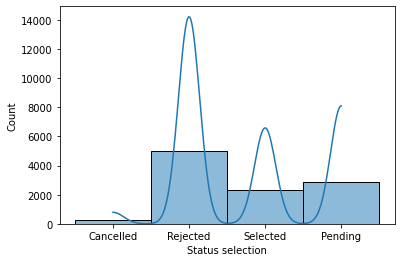

In [ ]:
sns.histplot(data=stay_wishes, x="Status selection", kde=True)

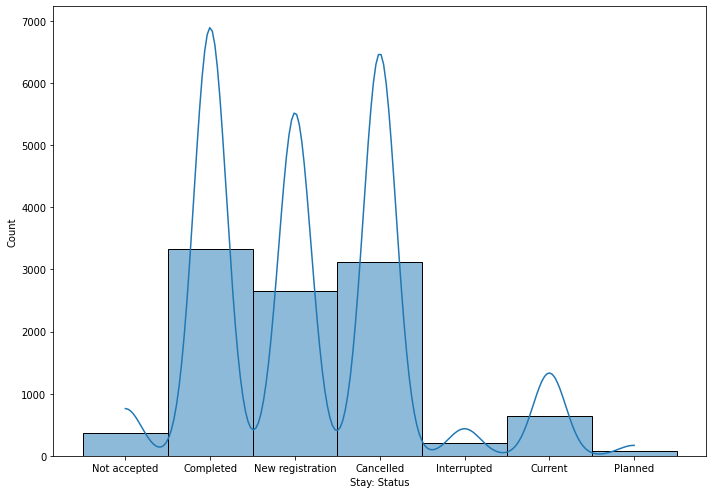

In [ ]:
a4_dims = (11.7, 8.27)
fig, ax = plt.subplots(figsize=a4_dims)
sns.histplot(ax=ax, data=stay_wishes, x="Stay: Status", kde=True)

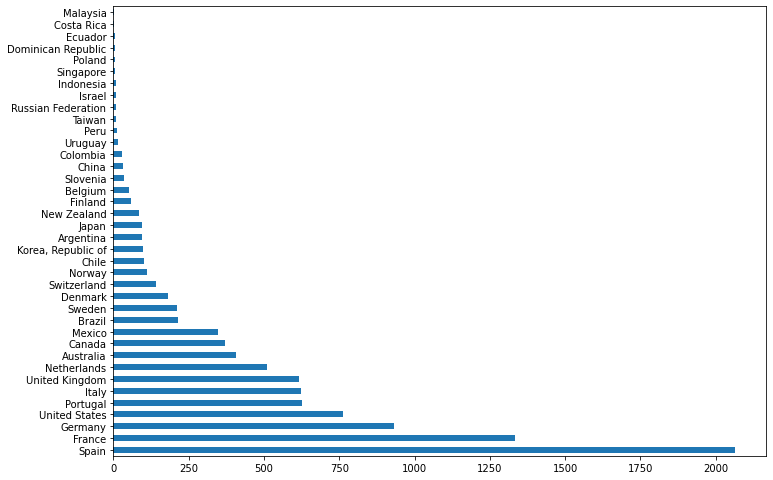

In [ ]:
a4_dims = (11.7, 8.27)
fig, ax = plt.subplots(figsize=a4_dims)
ax = stay_wishes['Country'].value_counts().plot.barh(ax=ax)

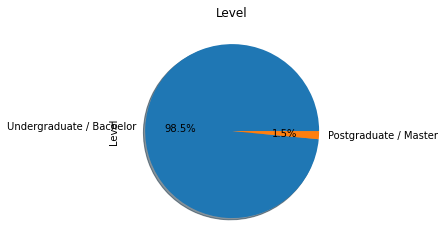

In [ ]:
stay_wishes['Level'].value_counts().plot.pie(y='', title="Level", legend=False, \
                   autopct='%1.1f%%', shadow=True, startangle=0)

## En el análisis exploratorio tenemos que:
1. La mayoría de postulaciones para realizar los intercambios son gente de pregrado exactamente el 98.3%
2. Los estudiantes prefieren postularse a España,Francia y Alemania, pues estos países son con los que más cuentan postulaciones
3.Del total de postulaciones tenemos que hay 4977 estudiantes que han sido rechazados desde el proceso de selección
4. Luego del proceso de selección tenemos que una gran proporción quedan completados (es decir, terminando el proceso de intercambio) 

In [ ]:
url = 'https://github.com/a-garcia13/Proyecto-Ciencia-de-datos-Aplicada/blob/main/Data/Flows%20(Sat%20Sep%2017%202022).xlsx?raw=true'
# Datos de los cupos
seats = pd.read_excel(url)
seats.head() #Veremos las primeras líneas del dataset, para ver si leyó correctamente

,Relation: Country,Relation: External institutions,Relation: Parent relation,Relation: Name,Academic year,Academic period,Number,Remaining seats,Total duration,Time unit,Relation: Relation ID,Relation: Direction,Relation: Level,Relation: Internal institutions,Relation: Reach
0,Germany,Universität Mannheim,Exchange Agreement-Universität Mannheim-School...,Exchange Student Undergraduate-Universität Man...,2018.0,Second Semester 2018,4.0,4.0,"4,00",Academic period,541,Outgoing,Undergraduate / Bachelor,"Anthropology Department, History Department, I...",Specific agreement
1,Italy,Politecnico di Milano,Exchange Agreement-Politecnico di Milano-Depar...,Exchange Student Undergraduate-Politecnico di ...,2018.0,Second Semester 2018,1.0,0.0,"1,00",Academic period,153,Outgoing,Undergraduate / Bachelor,"Architecture Department, School of Architectur...",Specific agreement
2,Italy,Politecnico di Milano,Exchange Agreement-Politecnico di Milano-Depar...,Exchange Student Undergraduate-Politecnico di ...,2019.0,First Semester 2019,1.0,0.0,"1,00",Academic period,153,Outgoing,Undergraduate / Bachelor,"Architecture Department, School of Architectur...",Specific agreement
3,Netherlands,"Maastricht University, Maastricht University -...",Exchange Agreement-Maastricht University-Schoo...,Exchange Student Undergraduate-Maastricht Univ...,2018.0,Second Semester 2018,7.0,1.0,"7,00",Academic period,981,Outgoing,Undergraduate / Bachelor,"School of Management, Universidad de Los Andes",Specific agreement
4,Germany,Universität Mannheim,Exchange Agreement-Universität Mannheim-System...,Exchange Student Undergraduate-Universität Man...,2018.0,Second Semester 2018,3.0,3.0,"3,00",Academic period,535,Outgoing,Undergraduate / Bachelor,"School of Engineering, Systems Engineering and...",Specific agreement


In [ ]:
seats.dtypes

Relation: Country                   object
Relation: External institutions     object
Relation: Parent relation           object
Relation: Name                      object
Academic year                      float64
Academic period                     object
Number                             float64
Remaining seats                    float64
Total duration                      object
Time unit                           object
Relation: Relation ID                int64
Relation: Direction                 object
Relation: Level                     object
Relation: Internal institutions     object
Relation: Reach                     object
dtype: object

In [ ]:
corr = seats.corr()
corr.style.background_gradient(cmap='coolwarm')

,Academic year,Number,Remaining seats,Relation: Relation ID
Academic year,1.000000,-0.045528,-0.204352,-0.358787
Number,-0.045528,1.000000,0.792317,0.011644
Remaining seats,-0.204352,0.792317,1.000000,0.050139
Relation: Relation ID,-0.358787,0.011644,0.050139,1.000000


## Distribución de los cupos abiertos

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


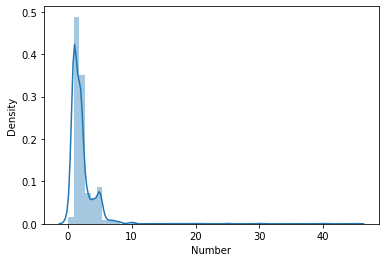

In [ ]:
sns.distplot(seats['Number'])

In [ ]:
seats_2=seats[seats['Academic year']>1967]

In [ ]:
agrupado=seats_2.groupby(['Academic year']).sum('Number')

# Sumamos la cantidad de cupos tanto por asignar como los que se abrieron por año

In [ ]:
agrupado

,Number,Remaining seats,Relation: Relation ID
Academic year,,,
2018.0,837.0,443.0,503009
2019.0,1372.0,801.0,907826
2020.0,1309.0,693.0,952989
2021.0,737.0,464.0,562705
2022.0,874.0,377.0,825962
2023.0,694.0,409.0,860809
2024.0,54.0,54.0,49498


### Analisis Bivariado para los cupos
1. La variable 'Number' Son los numeros de cupos que se abrieron, por lo tanto podemos observar que la distribución en los diferentes años no es tan dispersa
2. De igual manera la variable 'Remaining Seats' está correlacionada (0.79) y podemos observar el comportamiento de estas dos variables atraves de los (2018-2024), se puede observar que el pico más alto para estas dos es en 2019 y que tienden a cero en 2024

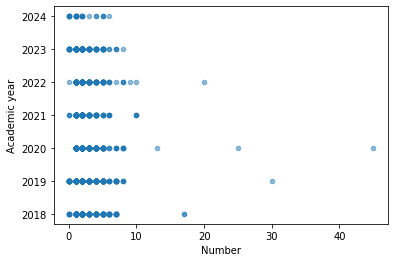

In [ ]:
seats_2.plot.scatter(x='Number', y='Academic year', alpha = 0.5)

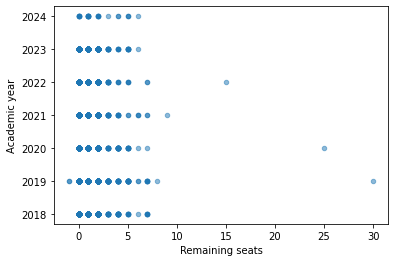

In [ ]:
seats_2.plot.scatter(x='Remaining seats', y='Academic year', alpha = 0.5)

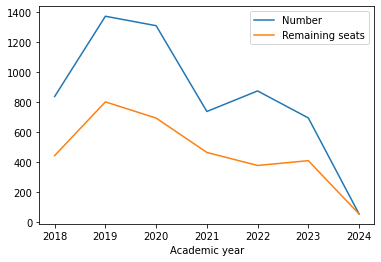

In [ ]:
agrupado.drop(columns=['Relation: Relation ID']).plot(legend=True)

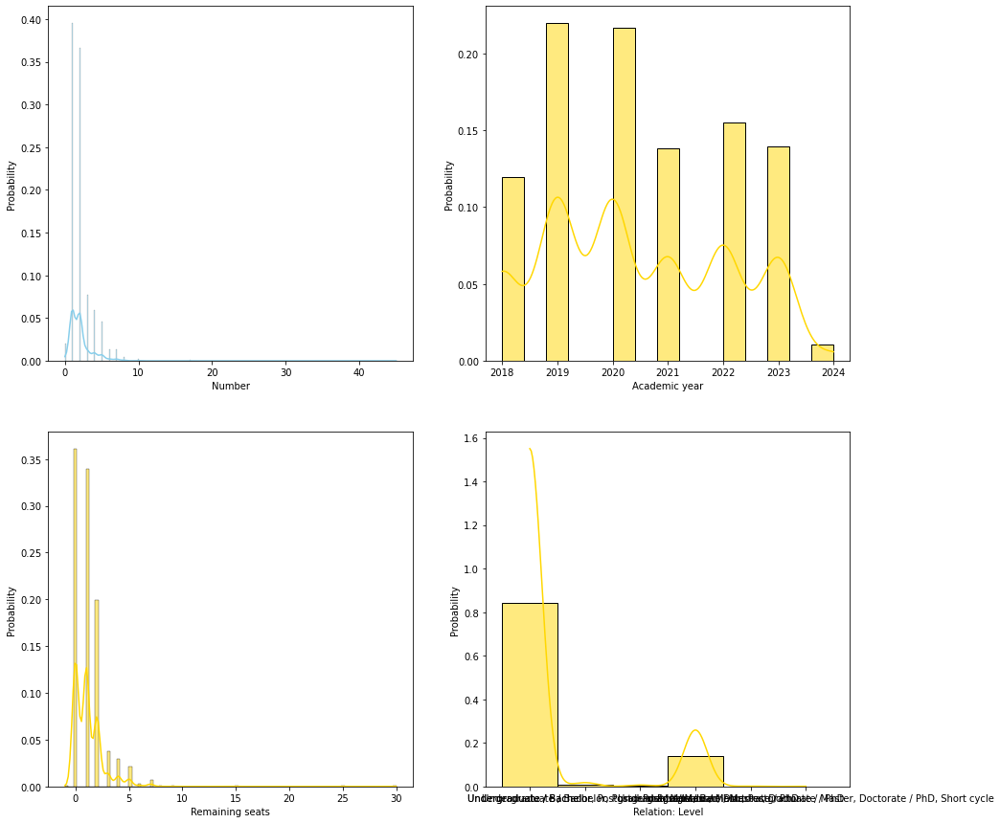

In [ ]:
fig, axs = plt.subplots(2, 2, figsize=(15, 15))

sns.histplot(data=seats_2, x="Number", kde=True, color="skyblue",stat='probability', ax=axs[0, 0])
sns.histplot(data=seats_2, x="Remaining seats", kde=True, color="gold",stat='probability', ax=axs[1, 0])
sns.histplot(data=seats_2, x="Academic year", kde=True, color="gold",stat='probability', ax=axs[0, 1])
sns.histplot(data=seats_2, x="Relation: Level", kde=True, color="gold",stat='probability', ax=axs[1, 1])

### De igual manera, observamos las probabilidades de las variables y notamos lo siguiente:
La postulaciones para los años 2019 y 2020 fueron bastante altas, de igual manera cuando los cupos estaban entre 0 y 10 la probabilidad de postulación es la mayor. Por último las personas de pregrado son las que más tienen probabiliades de postulación

In [ ]:
url = 'https://github.com/a-garcia13/Proyecto-Ciencia-de-datos-Aplicada/blob/main/Data/Institutions%20(Sat%20Sep%2017%202022).xlsx?raw=true'
# Datos de las instituciones
institutions = pd.read_excel(url)
institutions.head() #Veremos las primeras líneas del dataset, para ver si leyó correctamente

,Institution: ID,Country,Region 1,Region 2,Continent,City,Name,Institution type,Official Language,Language requirement 1,Language cerf score 1,Language requirement 2,Language cerf score 2,Language requirement 3,Language cerf score 3,Minimum GPA/4
0,2615,Colombia,South America,Latin America and the Caribbean,South America,NaN,ALISYS DIGITAL COLOMBIA SAS,Partner Company,Spanish,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1917,Cyprus,Western Asia,NaN,Asia,Nicosia,Πανεπιστήμιο Κύπρου,"Non Partner University - Potential, SGroup","Greek, Turkish",NaN,NaN,NaN,NaN,NaN,NaN,"2,6"
2,239,Finland,Northern Europe,NaN,Europe,Espoo,[no longer existing] Aalto-yliopisto,Partner University,"Swedish, Finnish",English,B2,NaN,NaN,NaN,NaN,"2,6"
3,279,France,Western Europe,NaN,Europe,Rouen,[No longer existing] Rouen Business School,Partner University,French,NaN,NaN,NaN,NaN,NaN,NaN,"2,6"
4,959,France,Western Europe,NaN,Europe,Nice,[no longer existing] Université Côte d’Azur,partner university,French,NaN,NaN,NaN,NaN,NaN,NaN,"2,6"


In [ ]:
institutions.groupby('Region 1').count()

,Institution: ID,Country,Region 2,Continent,City,Name,Institution type,Official Language,Language requirement 1,Language cerf score 1,Language requirement 2,Language cerf score 2,Language requirement 3,Language cerf score 3,Minimum GPA/4
Region 1,,,,,,,,,,,,,,,
Australia and New Zealand,61,61,0,61,59,61,61,61,11,11,0,0,0,0,47
Caribbean,11,11,11,11,11,11,11,11,0,0,0,0,0,0,6
Central America,72,72,72,72,68,72,72,72,0,0,0,0,0,0,60
Central Asia,3,3,0,3,3,3,3,3,0,0,0,0,0,0,3
Eastern Africa,3,3,3,3,2,3,3,3,0,0,0,0,0,0,2
Eastern Asia,232,232,0,232,231,232,232,232,11,11,3,3,0,0,221
Eastern Europe,70,70,0,70,68,70,70,70,3,3,0,0,0,0,62
Middle Africa,3,3,3,3,3,3,3,3,0,0,0,0,0,0,3
Northern Africa,11,11,0,11,11,11,11,11,0,0,0,0,0,0,11


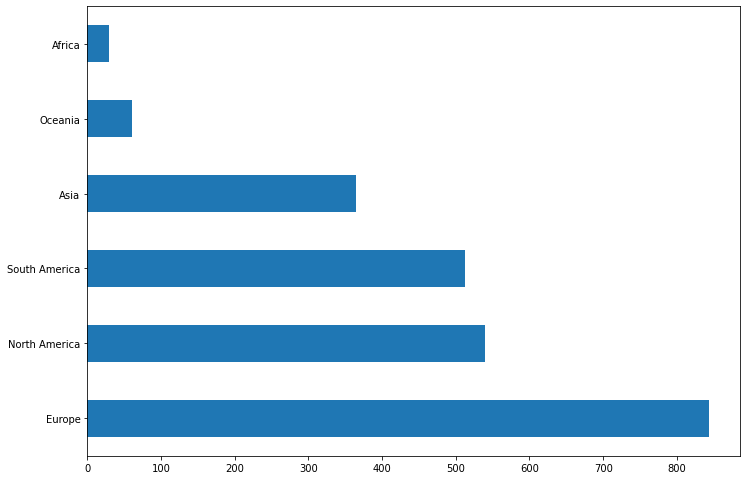

In [ ]:
a4_dims = (11.7, 8.27)
fig, ax = plt.subplots(figsize=a4_dims)
ax = institutions['Continent'].value_counts().plot.barh(ax=ax)

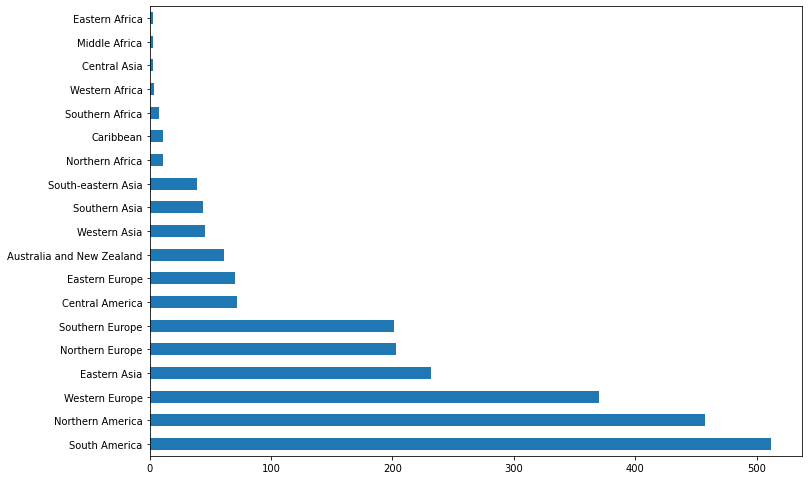

In [ ]:
a4_dims = (11.7, 8.27)
fig, ax = plt.subplots(figsize=a4_dims)
ax = institutions['Region 1'].value_counts().plot.barh(ax=ax)

##Como se observa en el gráfico anterior, el dataset de instituciones, son absolutamente todas las universidades que se manejan en la base de datos de MoveON, de esta manera miramos que la mayoría están en el continente europeo, sin embargo la región que más predomina es la region de sur america

In [ ]:
url = 'https://github.com/a-garcia13/Proyecto-Ciencia-de-datos-Aplicada/blob/main/Data/Relations%20(Sat%20Sep%2017%202022).xlsx?raw=true'
# Datos de los convenios y las stay opportunities
relations = pd.read_excel(url)
relations.head() #Veremos las primeras líneas del dataset, para ver si leyó correctamente

,Relation ID,Country,Main External Institutions,External institutions,Name,Relation type,Frameworks,Start date,End date,Status,Reach,Relation content,Last renewal,Degree programme,Internal institutions,Direction,Parent relation,Level,Main Internal Institutions
0,3975,Peru,Universidad Nacional Mayor de San Marcos,Universidad Nacional Mayor de San Marcos,SUI IURIS-Universidad Nacional Mayor de San M...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
1,3973,Brazil,Universidade de Brasilia (UnB),Universidade de Brasilia (UnB),SUI IURIS-Universidade de Brasilia-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
2,3967,Spain,Universitat Pompeu Fabra,Universitat Pompeu Fabra,SUI IURIS-Universitat Pompeu Fabra-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
3,2938,United Kingdom,University of Essex,University of Essex,"""Sustainability and Firm Performance"" Presenta...",Event,Presentation,13/02/2020,13/02/2020,Terminated,NaN,NaN,NaN,NaN,"Anthropology Department, Architecture Departme...",NaN,Exchange Agreement-University of Essex-Univers...,NaN,Universidad de Los Andes
4,2939,United Kingdom,University of Essex,University of Essex,“Modern Ruins -Political violence and cultural...,Event,Presentation,10/02/2020,10/02/2020,Terminated,NaN,NaN,NaN,NaN,"Anthropology Department, Architecture Departme...",NaN,NaN,NaN,Universidad de Los Andes


In [ ]:
relations.dtypes

Relation ID                    int64
Country                       object
Main External Institutions    object
External institutions         object
Name                          object
Relation type                 object
Frameworks                    object
Start date                    object
End date                      object
Status                        object
Reach                         object
Relation content              object
Last renewal                  object
Degree programme              object
Internal institutions         object
Direction                     object
Parent relation               object
Level                         object
Main Internal Institutions    object
dtype: object

In [ ]:
relations.groupby('Relation type').count()

,Relation ID,Country,Main External Institutions,External institutions,Name,Frameworks,Start date,End date,Status,Reach,Relation content,Last renewal,Degree programme,Internal institutions,Direction,Parent relation,Level,Main Internal Institutions
Relation type,,,,,,,,,,,,,,,,,,
Collaboration,33,31,31,31,33,33,10,2,33,15,13,0,0,33,0,0,0,33
Event,48,41,41,41,48,45,45,45,48,2,3,0,0,48,0,16,0,48
Network,27,25,25,25,27,24,22,7,27,16,13,3,0,27,0,0,0,27
Partnership,1336,1303,1303,1303,1336,1320,1243,1182,1336,1168,810,302,0,1334,0,71,0,1334
Project,14,8,8,8,14,10,11,9,14,0,0,0,0,14,0,0,0,14
Stay opportunity,2308,2277,2277,2277,2308,2303,1889,1781,2308,2305,1866,789,2092,2308,2308,2153,2177,2308
Visit,251,247,247,247,251,246,250,250,251,16,76,0,0,251,251,86,0,251


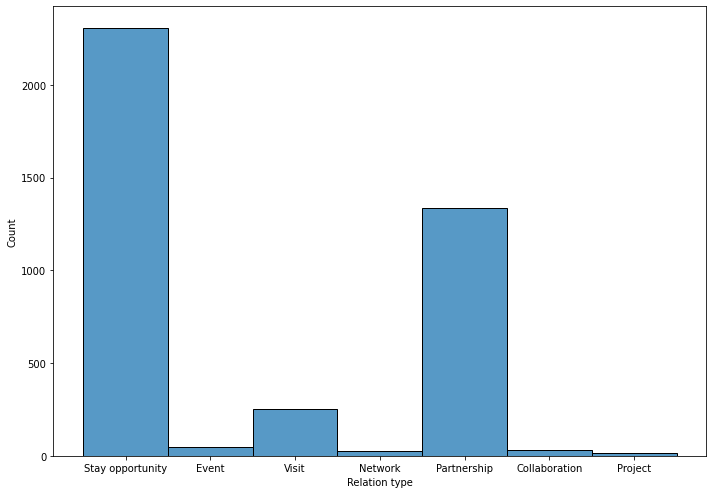

In [ ]:
a4_dims = (11.7, 8.27)
fig, ax = plt.subplots(figsize=a4_dims)
sns.histplot(ax=ax,data=relations, x="Relation type", kde=False)

## La mayor cantidad de Relaciones/Convenios, se dan por la oportunidad de quedarse y la siguiente mas aplicada es la de PartnerShip

##Se presenta una cantidad considerable en la relación de visita

In [ ]:
corr = relations.corr()
corr.style.background_gradient(cmap='coolwarm')

,Relation ID
Relation ID,1.000000


##Ahora realizaremos el analisis de los datos de cada tabla, Utilizaremos la libreria de `pandas-profiling` para realizar una exploración de datos profunda
###De igual manera podemos observar a detalle las correlaciones, la media, la cardinalidad, los missing values, sus distintos valores

##### Institucions

In [ ]:
ProfileReport(institutions)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

En la tabla de instituciones encontramos los siguientes hallazgos:
* Existen 2331 Instituciones diferentes en la tabla, y hay 3 duplicados.
* La lista contiene 101 paises diferentes, en donde el pais mas comun era Estados Unidos, seguido de Colombia, Francia, Reino Unido y España. No hay valores faltantes. 
* Existen 48 instituciones sin ciudades, y existen 1097 ciudades diferentes para todas las instituciones. 
Acciones a tomar:

* las ciudades no son relevantes por lo que se puede realizar un drop de la columna, o dejarla en la tabla.
* Es necesario quitar los duplicados, pero no sabemos como pueda afectar el join con las demas tablas por lo que se reexaminara mas adelante, en caso de ser necesario.


In [ ]:
institutions.drop(['City'], axis=1)
institutions.head()

,Institution: ID,Country,Region 1,Region 2,Continent,City,Name,Institution type,Official Language,Language requirement 1,Language cerf score 1,Language requirement 2,Language cerf score 2,Language requirement 3,Language cerf score 3,Minimum GPA/4
0,2615,Colombia,South America,Latin America and the Caribbean,South America,NaN,ALISYS DIGITAL COLOMBIA SAS,Partner Company,Spanish,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1917,Cyprus,Western Asia,NaN,Asia,Nicosia,Πανεπιστήμιο Κύπρου,"Non Partner University - Potential, SGroup","Greek, Turkish",NaN,NaN,NaN,NaN,NaN,NaN,"2,6"
2,239,Finland,Northern Europe,NaN,Europe,Espoo,[no longer existing] Aalto-yliopisto,Partner University,"Swedish, Finnish",English,B2,NaN,NaN,NaN,NaN,"2,6"
3,279,France,Western Europe,NaN,Europe,Rouen,[No longer existing] Rouen Business School,Partner University,French,NaN,NaN,NaN,NaN,NaN,NaN,"2,6"
4,959,France,Western Europe,NaN,Europe,Nice,[no longer existing] Université Côte d’Azur,partner university,French,NaN,NaN,NaN,NaN,NaN,NaN,"2,6"


##### Cupos (Seats)

In [ ]:
ProfileReport(seats)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

En la tabla de cupos encontramos los siguientes hallazgos:
* Existen 12 filas duplicadas exactamente iguales.
* Existen 9 instancias de cupos sin paises y sin instituciones especificas, examinando mas a fondo, estas corresponden a cupos para redes internacionales que no tienen pais fijo. 
* Existen 40 cupos sin vinculacion a convenios, y lo sabemos por la columna de Relation: Parent Relation.
* Existen unos cupos asignados al año 1967, que son los cupos de referencia de los convenios, estos deben ser eliminados. Estos mismos datos de 1967 corresponden a los datos sin semestre especifico.
* Existen 63 cupos sin numero especificado y 57 cupos con 0 cupos asignados.
* existen 63 cupos donde no se especifica el numero de cupos restantes.
* Existen 229 cupos sin duracion especificada.

Acciones a tomar:

* Es necesario remover los cupos de referencia de 1967
* Es necesario quitar los duplicados.
* Es necesario remover los los cupos donde no se especifica el numero de cupos.
* Es necesario remover los cupos que no correspondan a la convocatoria general de pregrado saliente que es donde realizaremos el modelo de regresion.


In [ ]:
seats = seats.dropna()
seats = seats.drop_duplicates()
seats = seats[seats['Academic year'] != 1967]
seats = seats[seats['Relation: Direction'] == 'Outgoing']
seats = seats[seats['Relation: Level'].str.contains("Undergraduate")]
seats = seats.drop(['Time unit'], axis=1)
ProfileReport(seats)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

##### Relations

In [ ]:
ProfileReport(relations)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

En la tabla de cupos encontramos los siguientes hallazgos:
* Existen 4 tipos de relaciones, Stay opportunities, que son a las cuales se les asignan directamente los cupos, Partnerships que son los convenios, Collaborations que son relaciones informales que pueden o no generar movilidades, y 27 redes de cooperacion interinstitucional.
* Solo las Stay Opportunities tienen carreras asignadas.
* Existen 1571 filas sin especificar el alcance de la relacion (Convenio general o Especifico) sin embargo esta informacion se puede derivar de las Stay Opportunities.
* Solo las Stay Opportunities tienen Nivel.
* Main Internal Instiutition es un columna constante.

Acciones a tomar:

* Es necesario separar las Stay Opportunities de los demas tipos de relaciones.
* Eliminar la columna de Main Internal Instiution.

##### Postulaciones

In [ ]:
ProfileReport(stay_wishes)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

En la tabla de postulaciones encontramos los siguientes hallazgos:
* Exiten una gran cantidad de filas con campos vacios, por esta razon, y para propositos del proyecto vamos a delimitar los intercambios a intercambios de pregrado de la convocatoria general de pregrado

Acciones a tomar:

* Seleccionar solo los datos cuyo nivel sea Undergraduate que corresponden a los intercambios que se quieren estudiar.
* Reevaluar el data set.

In [ ]:
#stay_wishes = stay_wishes.dropna()
#stay_wishes = stay_wishes.drop_duplicates()
stay_wishes = stay_wishes[stay_wishes['Level'] == 'Undergraduate / Bachelor']
stay_wishes = stay_wishes.drop(['Level'], axis=1)
ProfileReport(stay_wishes)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### 6.3 Respuesta a las Preguntas a contestar:
-	¿Cuáles son las carreras o facultades que utilizan más cupos en convenios generales?

Para contestar esta pregunta, primero debemos filtrar las postulaciones, a solo las seleccionadas, que representan las que efectivamente ocuparon un cupo en la convocatoria y que corresponden a un convenio general.

In [ ]:
stay_wishes_1 = stay_wishes 
stay_wishes_1 = stay_wishes_1[stay_wishes_1['Status selection'] == 'Selected']
stay_wishes_1 = stay_wishes_1[stay_wishes_1['Relation: Reach'] == 'University wide']
stay_wishes_1

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Frameworks,Status offer,...,Sub institution,Academic year,Duration periods,Stay: ID,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach
36,3492,9542,202010 - Outgoing,First Semester 2020,2.0,119.0,Exchange Student Undergraduate-Københavns Univ...,Selected,Exchange Student Undergraduate,Offer accepted,...,NaN,2020.0,1.0,8655,School of Arts and Humanities,Outgoing,Undergraduate / Bachelor,Completed,NaN,University wide
48,3004,9373,202010 - Outgoing,First Semester 2020,3.0,89.0,Exchange Student-Oslo and Akershus University ...,Selected,Exchange Student Undergraduate,Offer accepted,...,NaN,2020.0,1.0,8456,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Completed,NaN,University wide
71,8281,14340,202020 - VIP - JLU Giessen,First Semester 2020,1.0,3315.0,Virtual Mobility Program-Justus-Liebig-Univers...,Selected,Virtual Mobility Program,Offer accepted,...,School of Engineering,2020.0,1.0,14705,School of Engineering,Outgoing,Undergraduate / Bachelor,Completed,Master in Electrical Engineering,University wide
75,3002,4087,202010 - Outgoing,First Semester 2020,1.0,207.0,Exchange Student-Technische Universität Münche...,Selected,Exchange Student Undergraduate,Offer accepted,...,NaN,2020.0,1.0,8463,School of Sciences,Outgoing,Undergraduate / Bachelor,Completed,NaN,University wide
91,13248,17010,202220 - Outgoing,Second Semester 2022,2.0,1529.0,Exchange Student Undergraduate-École de Techno...,Selected,Exchange Student Undergraduate,Offer accepted,...,School of Engineering,2022.0,1.0,18385,School of Engineering,Outgoing,Undergraduate / Bachelor,New registration,Civil Engineering Bsc,University wide
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10351,15472,17212,202220 - Outgoing - Segunda ronda,Second Semester 2022,2.0,4484.0,Exchange Student Undergraduate-Université Pari...,Selected,Exchange Student Undergraduate,Offer accepted,...,School of Law,2022.0,1.0,19149,School of Law,Outgoing,Undergraduate / Bachelor,Current,Law Bsc,University wide
10362,10697,16100,202210 - Outgoing,First Semester 2022,1.0,139.0,Exchange Student-McGill University-Universidad...,Selected,Exchange Student Undergraduate,Offer accepted,...,[no longer existing] TELECOM Bretagne,2022.0,1.0,16559,School of Arts and Humanities,Outgoing,Undergraduate / Bachelor,Cancelled,History Bsc,University wide
10365,10566,16035,202210 - Outgoing,First Semester 2022,2.0,395.0,Exchange Student-University of Bristol-Univers...,Selected,Exchange Student Undergraduate,Offer accepted,...,Universidad Europea de Valencia,2022.0,1.0,16485,School of Engineering,Outgoing,Undergraduate / Bachelor,Current,Other Bsc,University wide
10381,13547,17182,202220 - Outgoing,Second Semester 2022,1.0,2497.0,CINDA-Exchange Student Undergraduate-Universit...,Selected,CINDA,Offer accepted,...,School of Engineering,2022.0,1.0,18531,School of Engineering,Outgoing,Undergraduate / Bachelor,New registration,Industrial Engineering Bsc,University wide


Ahora mostramos las 5 Facultades que mas utilizaron cupos:

In [ ]:
stay_wishes_1 = stay_wishes_1.groupby(['Person: Sub institution'])['Person: Sub institution'].count().sort_values(ascending=False)
stay_wishes_1

Person: Sub institution
School of Engineering                          177
School of Architecture and Design               92
School of Economics                             89
School of Social Sciences                       76
School of Sciences                              68
School of Law                                   58
School of Management                            42
School of Arts and Humanities                   35
Government School Alberto Lleras Camargo        25
School of Education                              2
School of Medicine                               2
School of Engineering, School of Management      1
Name: Person: Sub institution, dtype: int64

Ahora mostramos los 5 programas que mas utilizaron cupos generales:

In [ ]:
stay_wishes_1 = stay_wishes 
stay_wishes_1 = stay_wishes_1[stay_wishes_1['Status selection'] == 'Selected']
stay_wishes_1 = stay_wishes_1[stay_wishes_1['Relation: Reach'] == 'University wide']
stay_wishes_1 = stay_wishes_1.groupby(['Stay: Degree programme'])['Stay: Degree programme'].count().sort_values(ascending=False)
stay_wishes_1

Stay: Degree programme
Economics Bsc                                        63
Law Bsc                                              52
Design Bsc                                           39
Industrial Engineering Bsc                           39
Administration Bsc                                   31
Architecture Bsc                                     28
Systems and Computing Engineering Bsc                21
Physics Bsc                                          16
Biomedical Engineering Bsc                           16
Psychology Bsc                                       15
Anthropology Bsc                                     15
Biology Bsc                                          15
Mechanical Engineering Bsc                           14
Arts Bsc                                             14
Political Science Bsc                                12
Microbiology Bsc                                     12
Civil Engineering Bsc                                12
Government and Public Pol

-	¿Cuáles son las facultades que más postulaciones exitosas por convenios específicos tienen y cuál es su tasa de utilización de cupos específicos?

Primero veremos la utilizacion de cupos en convenios especificos

In [ ]:
stay_wishes_1 = stay_wishes 
stay_wishes_1 = stay_wishes_1[stay_wishes_1['Status selection'] == 'Selected']
stay_wishes_1 = stay_wishes_1[stay_wishes_1['Relation: Reach'] != 'University wide']
stay_wishes_1 = stay_wishes_1.groupby(['Person: Sub institution'])['Person: Sub institution'].count().sort_values(ascending=False)
stay_wishes_1

Person: Sub institution
School of Management                           320
School of Engineering                          317
School of Architecture and Design               97
School of Law                                   87
School of Economics                             82
School of Social Sciences                       43
Government School Alberto Lleras Camargo        15
School of Arts and Humanities                   10
School of Sciences                               6
School of Engineering, School of Management      1
Name: Person: Sub institution, dtype: int64

y ahora veremos cuantos cupos disponibles tienen las facultades para convenios especificos

In [ ]:
seats_1 = seats
seats_1 = seats_1[seats_1['Relation: Reach'] != 'University wide']
seats_1

,Relation: Country,Relation: External institutions,Relation: Parent relation,Relation: Name,Academic year,Academic period,Number,Remaining seats,Total duration,Relation: Relation ID,Relation: Direction,Relation: Level,Relation: Internal institutions,Relation: Reach
0,Germany,Universität Mannheim,Exchange Agreement-Universität Mannheim-School...,Exchange Student Undergraduate-Universität Man...,2018.0,Second Semester 2018,4.0,4.0,"4,00",541,Outgoing,Undergraduate / Bachelor,"Anthropology Department, History Department, I...",Specific agreement
1,Italy,Politecnico di Milano,Exchange Agreement-Politecnico di Milano-Depar...,Exchange Student Undergraduate-Politecnico di ...,2018.0,Second Semester 2018,1.0,0.0,"1,00",153,Outgoing,Undergraduate / Bachelor,"Architecture Department, School of Architectur...",Specific agreement
2,Italy,Politecnico di Milano,Exchange Agreement-Politecnico di Milano-Depar...,Exchange Student Undergraduate-Politecnico di ...,2019.0,First Semester 2019,1.0,0.0,"1,00",153,Outgoing,Undergraduate / Bachelor,"Architecture Department, School of Architectur...",Specific agreement
3,Netherlands,"Maastricht University, Maastricht University -...",Exchange Agreement-Maastricht University-Schoo...,Exchange Student Undergraduate-Maastricht Univ...,2018.0,Second Semester 2018,7.0,1.0,"7,00",981,Outgoing,Undergraduate / Bachelor,"School of Management, Universidad de Los Andes",Specific agreement
4,Germany,Universität Mannheim,Exchange Agreement-Universität Mannheim-System...,Exchange Student Undergraduate-Universität Man...,2018.0,Second Semester 2018,3.0,3.0,"3,00",535,Outgoing,Undergraduate / Bachelor,"School of Engineering, Systems Engineering and...",Specific agreement
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4550,France,Ecole des Mines de Saint-Etienne,Double Degree-Ecole des Mines de Saint-Etienne...,Double Degree-Exchange Student Undergraduate-E...,2023.0,Second Semester 2023,1.0,0.0,"1,00",4200,Outgoing,Undergraduate / Bachelor,"Biomedical Engineering Department, Civil and E...",Specific agreement
4551,France,IMT Atlantique,Double Degree-IMT Atlantique-School of Enginee...,Double Degree-Exchange Student Undergraduate-I...,2023.0,Second Semester 2023,1.0,0.0,"1,00",2326,Outgoing,Undergraduate / Bachelor,Electrical and Electronic Engineering Departme...,Specific agreement
4552,France,Ecole Centrale Nantes,Double Degree-Ecole Centrale Nantes-School of ...,Double Degree-Exchange Student Undergraduate-E...,2023.0,Second Semester 2023,1.0,0.0,"1,00",3586,Outgoing,Undergraduate / Bachelor,Civil and Environmental Engineering Department...,Specific agreement
4553,France,Grenoble INP - UGA,Double Degree Agreement-Grenoble INP-Systems E...,Double Degree-Exchange Student Undergraduate-G...,2023.0,Second Semester 2023,1.0,0.0,"1,00",2911,Outgoing,Undergraduate / Bachelor,"School of Engineering, Systems Engineering and...",Specific agreement


In [ ]:
Lista_facultades = dict.fromkeys(stay_wishes_1.index, 0)
for facultad in Lista_facultades:
  for index, row in seats_1.iterrows():
    if facultad in row['Relation: Internal institutions']:
      Lista_facultades[facultad] = Lista_facultades[facultad] + 1*row['Number']
Lista_facultades

{'School of Management': 781.0,
 'School of Engineering': 1138.0,
 'School of Architecture and Design': 325.0,
 'School of Law': 317.0,
 'School of Economics': 323.0,
 'School of Social Sciences': 378.0,
 'Government School Alberto Lleras Camargo': 129.0,
 'School of Arts and Humanities': 191.0,
 'School of Sciences': 130.0,
 'School of Engineering, School of Management': 1.0}

Ahora calcularemos la tasa de uso de cupos

In [ ]:
for facultad in Lista_facultades:
  for index, value in stay_wishes_1.items():
    if index == facultad:
      Lista_facultades[facultad] = Lista_facultades[facultad]/value
Lista_facultades

{'School of Management': 2.440625,
 'School of Engineering': 3.589905362776025,
 'School of Architecture and Design': 3.350515463917526,
 'School of Law': 3.6436781609195403,
 'School of Economics': 3.9390243902439024,
 'School of Social Sciences': 8.790697674418604,
 'Government School Alberto Lleras Camargo': 8.6,
 'School of Arts and Humanities': 19.1,
 'School of Sciences': 21.666666666666668,
 'School of Engineering, School of Management': 1.0}

-	¿Cuáles son las 30 universidades que más postulaciones de pregrado reciben?

In [ ]:
stay_wishes_1 = stay_wishes 
stay_wishes_1 = stay_wishes_1.groupby(['Institution'])['Institution'].count().sort_values(ascending=False)
stay_wishes_1.head(30)

Institution
Politecnico di Milano                                                  297
Universitat Ramon Llull                                                245
Universitat Politècnica de Catalunya                                   231
Universidad Politécnica de Madrid                                      212
University College London                                              201
Universidade de Lisboa                                                 178
Universität Mannheim                                                   170
Instituto Tecnológico y de Estudios Superiores de Monterrey (ITESM)    164
Justus-Liebig-Universität Giessen                                      156
Universidade do Porto                                                  141
Universidad de Málaga                                                  131
TOULOUSE BUSINESS SCHOOL                                               130
Universidad Carlos III de Madrid                                       128
Maastricht Un

-	¿Cuál es el porcentaje de postulaciones a las 30 universidades con más postulaciones?

In [ ]:
total = stay_wishes_1.sum()
total

7993

In [ ]:
percent = pd.Series(data=((stay_wishes_1.values / total) * 100), index=stay_wishes_1.index)
percent.head(30)

Institution
Politecnico di Milano                                                  3.715751
Universitat Ramon Llull                                                3.065182
Universitat Politècnica de Catalunya                                   2.890029
Universidad Politécnica de Madrid                                      2.652321
University College London                                              2.514700
Universidade de Lisboa                                                 2.226949
Universität Mannheim                                                   2.126861
Instituto Tecnológico y de Estudios Superiores de Monterrey (ITESM)    2.051795
Justus-Liebig-Universität Giessen                                      1.951708
Universidade do Porto                                                  1.764044
Universidad de Málaga                                                  1.638934
TOULOUSE BUSINESS SCHOOL                                               1.626423
Universidad Carlos III de Ma

-	¿Cuáles son las universidades con menos cupos utilizados?

In [ ]:
stay_wishes_1 = stay_wishes 
stay_wishes_1 = stay_wishes_1[stay_wishes_1['Status selection'] == 'Selected']
stay_wishes_1 = stay_wishes_1.groupby(['Institution'])['Institution'].count().sort_values(ascending=False)
stay_wishes_1.tail(30)

Institution
Ecole pour l'Informatique et les Techniques Avancées (EPITA)           1
Ecole Nationale Supérieure de l'Electronique et de ses Applications    1
ECAM Rennes                                                            1
Bucerius Law School - Hochschule für Rechtswissenschaft                1
Brandenburgische Technische Universität Cottbus-Senftenberg            1
Associação Escola da Cidade                                            1
Arts et Métiers ParisTech                                              1
Akademia Leona Koźmińskiego                                            1
Korea University                                                       1
Memorial University of Newfoundland                                    1
Nankai University                                                      1
National Chengchi University                                           1
University of Alberta                                                  1
Universitas Gadjah Mada                

-	¿Qué paises realizan mas intercambios?

In [ ]:
stay_wishes_1 = stay_wishes 
stay_wishes_1 = stay_wishes_1[stay_wishes_1['Status selection'] == 'Selected']
stay_wishes_1 = stay_wishes_1.groupby(['Country'])['Country'].count().sort_values(ascending=False)
stay_wishes_1.head(30)

Country
France                311
Germany               245
Spain                 190
Portugal              115
United States         101
Italy                  94
Netherlands            91
United Kingdom         91
Mexico                 75
Canada                 57
Brazil                 42
Denmark                38
Norway                 34
Australia              29
Switzerland            26
Chile                  20
Sweden                 19
Argentina              19
Belgium                15
Korea, Republic of     12
Finland                12
Japan                  11
New Zealand             9
Slovenia                7
Colombia                5
Peru                    4
Russian Federation      4
China                   4
Uruguay                 4
Poland                  2
Name: Country, dtype: int64

# Segunda Entrega

## 2. Experimentación y Modelos

### 2.1 Creación de la estructura de datos para la experimentación 

* Necesitamos conocer los siguientes datos especificos:
  - Numero de postulaciones por semestre Por Institución
  - Caracteristicas de la instiucion
  - Caracteristicas de los convenios de la institucion

#### 2.1.1 Numero de postulaciones:

In [ ]:
stay_wishes.head()

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Frameworks,Status offer,...,Sub institution,Academic year,Duration periods,Stay: ID,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach
0,3978,11131,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Cancelled,Research Internship,NaN,...,NaN,2020.0,1.0,11199,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Not accepted,NaN,Specific agreement
1,3990,11132,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Cancelled,Research Internship,NaN,...,NaN,2020.0,1.0,11204,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Not accepted,NaN,Specific agreement
2,3994,11133,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Rejected,Research Internship,NaN,...,NaN,2020.0,1.0,11207,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Completed,Architecture Bsc,Specific agreement
3,3998,11135,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Cancelled,Research Internship,NaN,...,NaN,2020.0,1.0,11209,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Not accepted,NaN,Specific agreement
4,4000,3989,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Rejected,Research Internship,NaN,...,NaN,2020.0,1.0,11210,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Completed,Design Bsc,Specific agreement


In [ ]:
stay_wishes.columns

Index(['Stay wish: ID', 'Person: ID', 'Form', 'Start period', 'Rank',
       'Relation: ID', 'Stay opportunity', 'Status selection', 'Frameworks',
       'Status offer', 'Country', 'Institution', 'Sub institution',
       'Academic year', 'Duration periods', 'Stay: ID',
       'Person: Sub institution', 'Relation: Direction', 'Relation: Level',
       'Stay: Status', 'Stay: Degree programme', 'Relation: Reach'],
      dtype='object')

In [ ]:
data = stay_wishes.copy()
data.head(5)

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Frameworks,Status offer,...,Sub institution,Academic year,Duration periods,Stay: ID,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach
0,3978,11131,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Cancelled,Research Internship,NaN,...,NaN,2020.0,1.0,11199,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Not accepted,NaN,Specific agreement
1,3990,11132,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Cancelled,Research Internship,NaN,...,NaN,2020.0,1.0,11204,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Not accepted,NaN,Specific agreement
2,3994,11133,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Rejected,Research Internship,NaN,...,NaN,2020.0,1.0,11207,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Completed,Architecture Bsc,Specific agreement
3,3998,11135,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Cancelled,Research Internship,NaN,...,NaN,2020.0,1.0,11209,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Not accepted,NaN,Specific agreement
4,4000,3989,2020 - Becas Pasantías Fac. Arquitectura y Diseño,First Semester 2020,2.0,2053.0,"Internship - University of California, Santa C...",Rejected,Research Internship,NaN,...,NaN,2020.0,1.0,11210,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Completed,Design Bsc,Specific agreement


In [ ]:
data.shape

(8174, 22)

In [ ]:
data = data[data['Form'].str.contains('- Outgoing')]
data.shape

(7634, 22)

In [ ]:
data['Frameworks'].unique()

array(['Exchange Student Undergraduate', 'SMILE', 'CINDA', nan, 'SURF',
       'Research Internship', 'GE3', 'HUC', 'Virtual Mobility Program',
       'Sui Iuris', 'Exchange Language', 'Medical Clerkship',
       'Exchange Student Undergraduate, SMILE', 'Proyecto de Grado',
       'Sígueme'], dtype=object)

In [ ]:
vacios = data[data['Frameworks'].isna()]
vacios

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Frameworks,Status offer,...,Sub institution,Academic year,Duration periods,Stay: ID,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach
87,2794,3038,201920 - Outgoing - Segunda ronda,Second Semester 2019,1.0,13.0,Exchange Student Undergraduate-Aston Universit...,Rejected,NaN,NaN,...,NaN,2019.0,1.0,7720,School of Management,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement
88,2795,3038,201920 - Outgoing - Segunda ronda,Second Semester 2019,2.0,1430.0,Exchange Student-McGill University-School of M...,Rejected,NaN,NaN,...,NaN,2019.0,1.0,7720,School of Management,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement
89,2796,3038,201920 - Outgoing - Segunda ronda,Second Semester 2019,3.0,531.0,Exchange Student Undergraduate-Kühne Logistics...,Selected,NaN,Offer refused,...,NaN,2019.0,1.0,7720,School of Management,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement
98,7700,13732,202110 - Outgoing - Segunda ronda,Second Semester 2021,1.0,191.0,Exchange Student Undergraduate-Queensland Univ...,Selected,NaN,Offer accepted,...,NaN,2021.0,1.0,13554,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Cancelled,Architecture Bsc,University wide
99,7706,13732,202110 - Outgoing - Segunda ronda,First Semester 2021,2.0,1241.0,SMILE-Exchange Student Undergraduate-Instituto...,Rejected,NaN,NaN,...,KEDGE Business School - Bordeaux,2021.0,1.0,13554,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Cancelled,Architecture Bsc,Specific agreement
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10110,9765,14908,202120 - Outgoing - Segunda ronda,Second Semester 2021,2.0,1676.0,Exchange Student Undergraduate-Université du Q...,Rejected,NaN,NaN,...,ISEP École d’ingénieurs du numérique,2021.0,1.0,15429,School of Engineering,Outgoing,Undergraduate / Bachelor,Cancelled,Industrial Engineering Bsc,University wide
10111,9766,14908,202120 - Outgoing - Segunda ronda,Second Semester 2021,3.0,184.0,Exchange Student Undergraduate-Pontificia Univ...,Rejected,NaN,NaN,...,ISEP École d’ingénieurs du numérique,2021.0,1.0,15429,School of Engineering,Outgoing,Undergraduate / Bachelor,Cancelled,Industrial Engineering Bsc,University wide
10238,15151,12950,202219 - Outgoing SURF Purdue,Inter-semester 2022,1.0,1023.0,SURF-Purdue University-Universidad de los Ande...,Rejected,NaN,NaN,...,Université de Strasbourg,2022.0,NaN,19748,School of Social Sciences,Outgoing,NaN,Not accepted,Biomedical Engineering Bsc,University wide
10300,15143,17752,202219 - Outgoing SURF Purdue,Inter-semester 2022,1.0,1023.0,SURF-Purdue University-Universidad de los Ande...,Selected,NaN,Offer accepted,...,Université de Strasbourg,2022.0,NaN,19743,School of Engineering,Outgoing,NaN,Completed,Civil Engineering Bsc,University wide


In [ ]:
relations.head(5)

,Relation ID,Country,Main External Institutions,External institutions,Name,Relation type,Frameworks,Start date,End date,Status,Reach,Relation content,Last renewal,Degree programme,Internal institutions,Direction,Parent relation,Level,Main Internal Institutions
0,3975,Peru,Universidad Nacional Mayor de San Marcos,Universidad Nacional Mayor de San Marcos,SUI IURIS-Universidad Nacional Mayor de San M...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
1,3973,Brazil,Universidade de Brasilia (UnB),Universidade de Brasilia (UnB),SUI IURIS-Universidade de Brasilia-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
2,3967,Spain,Universitat Pompeu Fabra,Universitat Pompeu Fabra,SUI IURIS-Universitat Pompeu Fabra-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
3,2938,United Kingdom,University of Essex,University of Essex,"""Sustainability and Firm Performance"" Presenta...",Event,Presentation,13/02/2020,13/02/2020,Terminated,NaN,NaN,NaN,NaN,"Anthropology Department, Architecture Departme...",NaN,Exchange Agreement-University of Essex-Univers...,NaN,Universidad de Los Andes
4,2939,United Kingdom,University of Essex,University of Essex,“Modern Ruins -Political violence and cultural...,Event,Presentation,10/02/2020,10/02/2020,Terminated,NaN,NaN,NaN,NaN,"Anthropology Department, Architecture Departme...",NaN,NaN,NaN,Universidad de Los Andes


In [ ]:
relations.columns

Index(['Relation ID', 'Country', 'Main External Institutions',
       'External institutions', 'Name', 'Relation type', 'Frameworks',
       'Start date', 'End date', 'Status', 'Reach', 'Relation content',
       'Last renewal', 'Degree programme', 'Internal institutions',
       'Direction', 'Parent relation', 'Level', 'Main Internal Institutions'],
      dtype='object')

In [ ]:
frm = relations[['Relation ID', 'Frameworks', 'Country', 'Main External Institutions']]
frm

,Relation ID,Frameworks,Country,Main External Institutions
0,3975,Sui Iuris,Peru,Universidad Nacional Mayor de San Marcos
1,3973,Sui Iuris,Brazil,Universidade de Brasilia (UnB)
2,3967,Sui Iuris,Spain,Universitat Pompeu Fabra
3,2938,Presentation,United Kingdom,University of Essex
4,2939,Presentation,United Kingdom,University of Essex
...,...,...,...,...
4012,3996,Virtual Mobility Program,United States,Princeton University
4013,3997,Virtual Mobility Program,United States,Princeton University
4014,1791,Higher Education Institution - HEI,Belgium,Vrije Universiteit Brussel
4015,1786,Non partner institution/Potential partner,Poland,Wyższa Szkoła Biznesu w Dąbrowie Górniczej


In [ ]:
data['Relation ID'] = data['Relation: ID']
data.drop('Relation: ID', axis=1)
data.columns

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


Index(['Stay wish: ID', 'Person: ID', 'Form', 'Start period', 'Rank',
       'Relation: ID', 'Stay opportunity', 'Status selection', 'Frameworks',
       'Status offer', 'Country', 'Institution', 'Sub institution',
       'Academic year', 'Duration periods', 'Stay: ID',
       'Person: Sub institution', 'Relation: Direction', 'Relation: Level',
       'Stay: Status', 'Stay: Degree programme', 'Relation: Reach',
       'Relation ID'],
      dtype='object')

In [ ]:
data =  pd.merge(data, frm, how='left', on = 'Relation ID')
data

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Frameworks_x,Status offer,...,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach,Relation ID,Frameworks_y,Country_y,Main External Institutions
0,7297,14278,202020 - Outgoing,Second Semester 2020,1.0,429.0,Exchange Student-University of New South Wales...,Selected,Exchange Student Undergraduate,Offer accepted,...,School of Law,Outgoing,Undergraduate / Bachelor,Completed,Law Bsc,Specific agreement,429.0,Exchange Student Undergraduate,Australia,University of New South Wales
1,17078,19186,202310 - Outgoing,First Semester 2023,1.0,395.0,Exchange Student-University of Bristol-Univers...,Pending,Exchange Student Undergraduate,NaN,...,School of Economics,Outgoing,Undergraduate / Bachelor,New registration,Economics Bsc,University wide,395.0,Exchange Student Undergraduate,United Kingdom,University of Bristol
2,4338,11728,202020 - Outgoing,Second Semester 2021,1.0,733.0,Exchange Student Undergraduate-National Chengc...,Selected,Exchange Student Undergraduate,Offer accepted,...,School of Management,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,733.0,Exchange Student Undergraduate,Taiwan,National Chengchi University
3,4339,11728,202020 - Outgoing,Second Semester 2020,2.0,149.0,Exchange Student Undergraduate-Nova School of ...,Rejected,Exchange Student Undergraduate,NaN,...,School of Management,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,149.0,Exchange Student Undergraduate,Portugal,Universidade Nova de Lisboa
4,4597,11728,202020 - Outgoing,Second Semester 2020,3.0,981.0,Exchange Student Undergraduate-Maastricht Univ...,Rejected,Exchange Student Undergraduate,NaN,...,School of Management,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,981.0,Exchange Student Undergraduate,Netherlands,Maastricht University
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7629,17801,18992,202310 - Outgoing - Segunda ronda,First Semester 2023,2.0,4710.0,Exchange Student Undergraduate-Université de S...,Rejected,Exchange Student Undergraduate,NaN,...,School of Management,Outgoing,Undergraduate / Bachelor,New registration,Administration Bsc,Specific agreement,4710.0,Exchange Student Undergraduate,France,Université de Strasbourg
7630,17804,18992,202310 - Outgoing - Segunda ronda,First Semester 2023,3.0,2259.0,Exchange Student-Université Paris-Dauphine-Sch...,Rejected,Exchange Student Undergraduate,NaN,...,School of Management,Outgoing,Undergraduate / Bachelor,New registration,Administration Bsc,Specific agreement,2259.0,Exchange Student Undergraduate,France,Université Paris Dauphine-PSL
7631,4237,11679,202020 - Outgoing,Second Semester 2021,1.0,1024.0,Exchange Student Undergraduate-Technische Univ...,Selected,Exchange Student Undergraduate,Offer accepted,...,School of Engineering,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,1024.0,Exchange Student Undergraduate,Netherlands,Technische Universiteit Eindhoven
7632,4240,11679,202020 - Outgoing,Second Semester 2020,2.0,136.0,SMILE-Exchange Student Undergraduate-Lunds Uni...,Rejected,Exchange Student Undergraduate,NaN,...,School of Engineering,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,136.0,"Exchange Student Undergraduate,SMILE",Sweden,Lunds universitet


In [ ]:
data.loc[data['Frameworks_x'].isna(),'Frameworks_x'] = data['Frameworks_y']
data['Frameworks_x'].unique()

array(['Exchange Student Undergraduate', 'SMILE', 'CINDA',
       'Exchange Student Undergraduate,SMILE', 'SURF',
       'Research Internship', 'GE3', nan, 'HUC',
       'Virtual Mobility Program', 'Study Abroad',
       'Exchange Student Undergraduate,Study Abroad', 'Sui Iuris',
       'CINDA,Exchange Student Undergraduate', 'Exchange Language',
       'Medical Clerkship', 'Exchange Student Undergraduate, SMILE',
       'Proyecto de Grado', 'Sígueme'], dtype=object)

In [ ]:
vacios = data[data['Frameworks_x'].isna()]
vacios

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Frameworks_x,Status offer,...,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach,Relation ID,Frameworks_y,Country_y,Main External Institutions
167,15891,18459,202220 - Outgoing - Arq - Lund University - Be...,Second Semester 2022,1.0,NaN,NaN,Pending,NaN,NaN,...,School of Architecture and Design,NaN,NaN,New registration,Architecture Bsc,NaN,NaN,NaN,NaN,NaN
848,15931,18495,202220 - Outgoing - Arq - Lund University - Be...,Second Semester 2022,1.0,NaN,NaN,Pending,NaN,NaN,...,NaN,NaN,NaN,New registration,Architecture Bsc,NaN,NaN,NaN,NaN,NaN
1100,15932,18504,202220 - Outgoing - Arq - Lund University - Be...,Second Semester 2022,1.0,NaN,NaN,Pending,NaN,NaN,...,School of Architecture and Design,NaN,NaN,New registration,Architecture Bsc,NaN,NaN,NaN,NaN,NaN
1319,15902,18474,202220 - Outgoing - Arq - Lund University - Be...,Second Semester 2022,1.0,NaN,NaN,Pending,NaN,NaN,...,School of Architecture and Design,NaN,NaN,Current,Architecture Bsc,NaN,NaN,NaN,NaN,NaN
1379,15913,18485,202220 - Outgoing - Arq - Lund University - Be...,Second Semester 2022,1.0,NaN,NaN,Pending,NaN,NaN,...,School of Architecture and Design,NaN,NaN,New registration,Architecture Bsc,NaN,NaN,NaN,NaN,NaN
1650,15895,18465,202220 - Outgoing - Arq - Lund University - Be...,Second Semester 2022,1.0,NaN,NaN,Pending,NaN,NaN,...,School of Architecture and Design,NaN,NaN,New registration,Architecture Bsc,NaN,NaN,NaN,NaN,NaN
2109,15905,16006,202220 - Outgoing - Arq - Lund University - Be...,Second Semester 2022,1.0,NaN,NaN,Pending,NaN,NaN,...,School of Architecture and Design,NaN,NaN,New registration,Architecture Bsc,NaN,NaN,NaN,NaN,NaN
2224,15908,18480,202220 - Outgoing - Arq - Lund University - Be...,Second Semester 2022,1.0,NaN,NaN,Pending,NaN,NaN,...,School of Architecture and Design,NaN,NaN,New registration,Architecture Bsc,NaN,NaN,NaN,NaN,NaN
2617,9859,14930,202120 - Outgoing - Segunda ronda,Second Semester 2021,1.0,NaN,Exchange Student-Université Paris Dauphine-Sch...,Selected,NaN,Offer accepted,...,School of Economics,NaN,NaN,Cancelled,Economics Bsc,Specific agreement,NaN,NaN,NaN,NaN
2637,15884,18458,202220 - Outgoing - Arq - Lund University - Be...,Second Semester 2022,1.0,NaN,NaN,Pending,NaN,NaN,...,School of Architecture and Design,NaN,NaN,New registration,Architecture Bsc,NaN,NaN,NaN,NaN,NaN


In [ ]:
data = data[data['Frameworks_x'].notna()]
data

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Frameworks_x,Status offer,...,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach,Relation ID,Frameworks_y,Country_y,Main External Institutions
0,7297,14278,202020 - Outgoing,Second Semester 2020,1.0,429.0,Exchange Student-University of New South Wales...,Selected,Exchange Student Undergraduate,Offer accepted,...,School of Law,Outgoing,Undergraduate / Bachelor,Completed,Law Bsc,Specific agreement,429.0,Exchange Student Undergraduate,Australia,University of New South Wales
1,17078,19186,202310 - Outgoing,First Semester 2023,1.0,395.0,Exchange Student-University of Bristol-Univers...,Pending,Exchange Student Undergraduate,NaN,...,School of Economics,Outgoing,Undergraduate / Bachelor,New registration,Economics Bsc,University wide,395.0,Exchange Student Undergraduate,United Kingdom,University of Bristol
2,4338,11728,202020 - Outgoing,Second Semester 2021,1.0,733.0,Exchange Student Undergraduate-National Chengc...,Selected,Exchange Student Undergraduate,Offer accepted,...,School of Management,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,733.0,Exchange Student Undergraduate,Taiwan,National Chengchi University
3,4339,11728,202020 - Outgoing,Second Semester 2020,2.0,149.0,Exchange Student Undergraduate-Nova School of ...,Rejected,Exchange Student Undergraduate,NaN,...,School of Management,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,149.0,Exchange Student Undergraduate,Portugal,Universidade Nova de Lisboa
4,4597,11728,202020 - Outgoing,Second Semester 2020,3.0,981.0,Exchange Student Undergraduate-Maastricht Univ...,Rejected,Exchange Student Undergraduate,NaN,...,School of Management,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,981.0,Exchange Student Undergraduate,Netherlands,Maastricht University
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7629,17801,18992,202310 - Outgoing - Segunda ronda,First Semester 2023,2.0,4710.0,Exchange Student Undergraduate-Université de S...,Rejected,Exchange Student Undergraduate,NaN,...,School of Management,Outgoing,Undergraduate / Bachelor,New registration,Administration Bsc,Specific agreement,4710.0,Exchange Student Undergraduate,France,Université de Strasbourg
7630,17804,18992,202310 - Outgoing - Segunda ronda,First Semester 2023,3.0,2259.0,Exchange Student-Université Paris-Dauphine-Sch...,Rejected,Exchange Student Undergraduate,NaN,...,School of Management,Outgoing,Undergraduate / Bachelor,New registration,Administration Bsc,Specific agreement,2259.0,Exchange Student Undergraduate,France,Université Paris Dauphine-PSL
7631,4237,11679,202020 - Outgoing,Second Semester 2021,1.0,1024.0,Exchange Student Undergraduate-Technische Univ...,Selected,Exchange Student Undergraduate,Offer accepted,...,School of Engineering,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,1024.0,Exchange Student Undergraduate,Netherlands,Technische Universiteit Eindhoven
7632,4240,11679,202020 - Outgoing,Second Semester 2020,2.0,136.0,SMILE-Exchange Student Undergraduate-Lunds Uni...,Rejected,Exchange Student Undergraduate,NaN,...,School of Engineering,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,136.0,"Exchange Student Undergraduate,SMILE",Sweden,Lunds universitet


In [ ]:
data['Frameworks'] = data['Frameworks_x']
data = data.drop(['Frameworks_y', 'Frameworks_x'], axis=1)
data.columns

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


Index(['Stay wish: ID', 'Person: ID', 'Form', 'Start period', 'Rank',
       'Relation: ID', 'Stay opportunity', 'Status selection', 'Status offer',
       'Country_x', 'Institution', 'Sub institution', 'Academic year',
       'Duration periods', 'Stay: ID', 'Person: Sub institution',
       'Relation: Direction', 'Relation: Level', 'Stay: Status',
       'Stay: Degree programme', 'Relation: Reach', 'Relation ID', 'Country_y',
       'Main External Institutions', 'Frameworks'],
      dtype='object')

In [ ]:
data['Frameworks'].unique()

array(['Exchange Student Undergraduate', 'SMILE', 'CINDA',
       'Exchange Student Undergraduate,SMILE', 'SURF',
       'Research Internship', 'GE3', 'HUC', 'Virtual Mobility Program',
       'Study Abroad', 'Exchange Student Undergraduate,Study Abroad',
       'Sui Iuris', 'CINDA,Exchange Student Undergraduate',
       'Exchange Language', 'Medical Clerkship',
       'Exchange Student Undergraduate, SMILE', 'Proyecto de Grado',
       'Sígueme'], dtype=object)

In [ ]:
data.loc[data["Frameworks"] == "Exchange Student Undergraduate,SMILE", "Frameworks"] = 'SMILE'
data.loc[data["Frameworks"] == "Exchange Student Undergraduate,Study Abroad", "Frameworks"] = 'Study Abroad'
data.loc[data["Frameworks"] == "CINDA,Exchange Student Undergraduate", "Frameworks"] = 'CINDA'
data.loc[data["Frameworks"] == "Exchange Student Undergraduate, SMILE", "Frameworks"] = 'SMILE'
data['Frameworks'].unique()

array(['Exchange Student Undergraduate', 'SMILE', 'CINDA', 'SURF',
       'Research Internship', 'GE3', 'HUC', 'Virtual Mobility Program',
       'Study Abroad', 'Sui Iuris', 'Exchange Language',
       'Medical Clerkship', 'Proyecto de Grado', 'Sígueme'], dtype=object)

In [ ]:
data = data[data['Frameworks'] != 'SURF']
data = data[data['Frameworks'] != 'Research Internship']
data = data[data['Frameworks'] != 'HUC']
data = data[data['Frameworks'] != 'Virtual Mobility Program']
data = data[data['Frameworks'] != 'Medical Clerkship']
data = data[data['Frameworks'] != 'Proyecto de Grado']
data = data[data['Frameworks'] != 'Sígueme']
data = data[data['Frameworks'] != 'GE3']
data = data[data['Frameworks'] != 'Sui Iuris']
data.shape

(7400, 25)

In [ ]:
data = data[data['Relation ID'].notna()]
data.shape

(7394, 25)

In [ ]:
vacios = data[data['Country_x'].isna()]
vacios

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Status offer,Country_x,...,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach,Relation ID,Country_y,Main External Institutions,Frameworks
273,3694,10150,201920 - TEC-Líderes del mañana - Outgoing,Second Semester 2019,1.0,1880.0,Exchange Student-Líderes del mañana-TEC MONTER...,Pending,NaN,NaN,...,School of Social Sciences,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,University wide,1880.0,Mexico,Instituto Tecnológico y de Estudios Superiores...,Exchange Student Undergraduate
274,3695,10150,201920 - TEC-Líderes del mañana - Outgoing,Second Semester 2019,2.0,1892.0,Exchange Student-Líderes del mañana-TEC GUADAL...,Pending,NaN,NaN,...,School of Social Sciences,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,University wide,1892.0,Mexico,Instituto Tecnológico y de Estudios Superiores...,Exchange Student Undergraduate
376,3676,10139,201920 - TEC-Líderes del mañana - Outgoing,Second Semester 2019,1.0,783.0,Exchange Student-Líderes del mañana-TEC PUEBLA...,Pending,NaN,NaN,...,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,University wide,783.0,Mexico,Instituto Tecnológico y de Estudios Superiores...,Exchange Student Undergraduate
377,3677,10139,201920 - TEC-Líderes del mañana - Outgoing,Second Semester 2019,2.0,1880.0,Exchange Student-Líderes del mañana-TEC MONTER...,Pending,NaN,NaN,...,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,University wide,1880.0,Mexico,Instituto Tecnológico y de Estudios Superiores...,Exchange Student Undergraduate
488,3764,10202,201920 - TEC-Líderes del mañana - Outgoing,Second Semester 2019,1.0,1892.0,Exchange Student-Líderes del mañana-TEC GUADAL...,Pending,NaN,NaN,...,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,University wide,1892.0,Mexico,Instituto Tecnológico y de Estudios Superiores...,Exchange Student Undergraduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7063,3718,10168,201920 - TEC-Líderes del mañana - Outgoing,Second Semester 2019,1.0,783.0,Exchange Student-Líderes del mañana-TEC PUEBLA...,Selected,Offer accepted,NaN,...,School of Arts and Humanities,Outgoing,Undergraduate / Bachelor,Completed,Arts Bsc,University wide,783.0,Mexico,Instituto Tecnológico y de Estudios Superiores...,Exchange Student Undergraduate
7064,3719,10168,201920 - TEC-Líderes del mañana - Outgoing,Second Semester 2019,2.0,1880.0,Exchange Student-Líderes del mañana-TEC MONTER...,Rejected,NaN,NaN,...,School of Arts and Humanities,Outgoing,Undergraduate / Bachelor,Completed,Arts Bsc,University wide,1880.0,Mexico,Instituto Tecnológico y de Estudios Superiores...,Exchange Student Undergraduate
7107,3735,10181,201920 - TEC-Líderes del mañana - Outgoing,Second Semester 2019,1.0,1880.0,Exchange Student-Líderes del mañana-TEC MONTER...,Selected,Offer accepted,NaN,...,School of Sciences,Outgoing,Undergraduate / Bachelor,Completed,Microbiology Bsc,University wide,1880.0,Mexico,Instituto Tecnológico y de Estudios Superiores...,Exchange Student Undergraduate
7243,3662,10126,201920 - TEC-Líderes del mañana - Outgoing,Second Semester 2019,1.0,1880.0,Exchange Student-Líderes del mañana-TEC MONTER...,Pending,NaN,NaN,...,School of Engineering,Outgoing,Undergraduate / Bachelor,Cancelled,NaN,University wide,1880.0,Mexico,Instituto Tecnológico y de Estudios Superiores...,Exchange Student Undergraduate


In [ ]:
data.loc[data['Country_x'].isna(),'Country_x'] = data['Country_y']
data['Country_x'].unique()

array(['Australia', 'United Kingdom', 'Taiwan', 'Portugal', 'Netherlands',
       'Spain', 'Italy', 'Germany', 'France', 'Mexico', 'United States',
       'Denmark', 'Sweden', 'Norway', 'Brazil', 'Chile', 'Argentina',
       'Korea, Republic of', 'Canada', 'Colombia', 'Belgium',
       'Switzerland', 'Finland', 'Slovenia', 'Japan', 'Uruguay',
       'New Zealand', 'Russian Federation', 'China', 'Poland',
       'Costa Rica', 'Indonesia', 'Peru', 'Dominican Republic'],
      dtype=object)

In [ ]:
data.loc[data['Institution'].isna(),'Institution'] = data['Main External Institutions']
data['Institution'].unique()

array(['University of New South Wales', 'University of Bristol',
       'National Chengchi University', 'Universidade Nova de Lisboa',
       'Maastricht University', 'Universidad Carlos III de Madrid',
       "Università Commerciale 'Luigi Bocconi' di Milano",
       'Universität Mannheim', 'Universitat Ramon Llull',
       'Université Toulouse 1 Capitole', 'Université de Strasbourg',
       'Université Jean Moulin Lyon 3',
       'Universitat Politècnica de Catalunya',
       'Universidad Politécnica de Madrid', 'Politecnico di Milano',
       'Universitat Politècnica de València', 'Universidad de Alicante',
       'Instituto Tecnológico y de Estudios Superiores de Monterrey (ITESM)',
       'Tulane University', 'Purdue University', 'University of Sussex',
       'Københavns Universitet', 'University of San Diego',
       'University of Technology Sydney',
       'Kungliga Tekniska högskolan (KTH)',
       'École de Communication Visuelle Paris',
       'Høgskolen i Oslo og Akershus 

In [ ]:
mal = data[data['Institution']=='Universidad de Los Andes']
mal

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Status offer,Country_x,...,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach,Relation ID,Country_y,Main External Institutions,Frameworks
1700,13415,17172,202220 - Outgoing,Second Semester 2022,1.0,2262.0,Exchange Student Undergraduate-Université Pari...,Selected,Offer accepted,Colombia,...,School of Economics,Outgoing,Undergraduate / Bachelor,Current,Economics Bsc,Specific agreement,2262.0,France,Université Paris Dauphine-PSL,Exchange Student Undergraduate
6622,19528,21342,202320 - Outgoing,Second Semester 2023,3.0,1292.0,Exchange Student Undergraduate-Jönköping Unive...,Pending,NaN,Colombia,...,School of Management,Outgoing,Undergraduate / Bachelor,New registration,Administration Bsc,Specific agreement,1292.0,Sweden,Jönköping University,Exchange Student Undergraduate
6943,10965,15897,202210 - Outgoing - Segunda ronda,First Semester 2022,1.0,1519.0,Exchange Student Undergraduate-Universidad de ...,Selected,Offer accepted,Colombia,...,School of Architecture and Design,Outgoing,Undergraduate / Bachelor,Completed,Architecture Bsc,University wide,1519.0,Spain,Universidad de Alicante,Exchange Student Undergraduate


In [ ]:
data.loc[data['Institution']=='Universidad de Los Andes','Country_x'] = data['Country_y']
data.loc[data['Institution']=='Universidad de Los Andes','Institution'] = data['Main External Institutions']
mal = data[data['Institution']=='Universidad de Los Andes']
mal

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Status offer,Country_x,...,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach,Relation ID,Country_y,Main External Institutions,Frameworks


In [ ]:
vacios = data[data['Country_x'].isna()]
vacios

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Status offer,Country_x,...,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach,Relation ID,Country_y,Main External Institutions,Frameworks


In [ ]:
vacios = data[data['Institution'].isna()]
vacios

,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Status offer,Country_x,...,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach,Relation ID,Country_y,Main External Institutions,Frameworks


In [ ]:
incoming = data[data['Relation: Direction'] == 'Incoming']
incoming


,Stay wish: ID,Person: ID,Form,Start period,Rank,Relation: ID,Stay opportunity,Status selection,Status offer,Country_x,...,Person: Sub institution,Relation: Direction,Relation: Level,Stay: Status,Stay: Degree programme,Relation: Reach,Relation ID,Country_y,Main External Institutions,Frameworks
917,2028,4021,201910 - Outgoing - Segunda ronda,First Semester 2019,3.0,1051.0,Exchange Student-Université de Bordeaux-School...,Cancelled,No Offer,France,...,"School of Engineering, School of Management",Incoming,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,1051.0,France,Université de Bordeaux,Exchange Student Undergraduate
4046,8770,14659,202120 - Outgoing,Second Semester 2021,1.0,1247.0,SMILE-Exchange Student Undergraduate-Instituto...,Selected,Offer accepted,Portugal,...,School of Engineering,Incoming,Undergraduate / Bachelor,Completed,Biomedical Engineering Bsc,Specific agreement,1247.0,Portugal,Universidade de Lisboa,SMILE
4994,10092,15845,202210 - Outgoing,First Semester 2022,1.0,1247.0,SMILE-Exchange Student Undergraduate-Instituto...,Selected,Offer accepted,Portugal,...,School of Engineering,Incoming,Undergraduate / Bachelor,Completed,Biomedical Engineering Bsc,Specific agreement,1247.0,Portugal,Universidade de Lisboa,SMILE
5974,8570,14600,202120 - Outgoing,Second Semester 2021,1.0,1247.0,SMILE-Exchange Student Undergraduate-Instituto...,Selected,Offer accepted,Portugal,...,School of Engineering,Incoming,Undergraduate / Bachelor,Completed,Biomedical Engineering Bsc,Specific agreement,1247.0,Portugal,Universidade de Lisboa,SMILE
6041,2038,4170,201910 - Outgoing - Segunda ronda,First Semester 2019,1.0,1051.0,Exchange Student-Université de Bordeaux-School...,Cancelled,No Offer,France,...,NaN,Incoming,Undergraduate / Bachelor,Cancelled,NaN,Specific agreement,1051.0,France,Université de Bordeaux,Exchange Student Undergraduate


In [ ]:
incoming['Stay opportunity'].unique()

array(['Exchange Student-Université de Bordeaux-School of Economics-School of Social Sciences-School of Law-Incoming',
       'SMILE-Exchange Student Undergraduate-Instituto Técnico Superior-Universidade Técnica de Lisboa-Department of Biomedical Engineering -Incoming'],
      dtype=object)

In [ ]:
incoming['Relation ID'].unique()

array([1051., 1247.])

In [ ]:
data = data[data['Relation: Direction'] != 'Incoming']
data['Relation: Direction'].unique()

array(['Outgoing'], dtype=object)

In [ ]:
ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
data.columns

Index(['Stay wish: ID', 'Person: ID', 'Form', 'Start period', 'Rank',
       'Relation: ID', 'Stay opportunity', 'Status selection', 'Status offer',
       'Country_x', 'Institution', 'Sub institution', 'Academic year',
       'Duration periods', 'Stay: ID', 'Person: Sub institution',
       'Relation: Direction', 'Relation: Level', 'Stay: Status',
       'Stay: Degree programme', 'Relation: Reach', 'Relation ID', 'Country_y',
       'Main External Institutions', 'Frameworks'],
      dtype='object')

In [ ]:
data['Country'] = data['Country_x'] 
data = data.drop(['Stay wish: ID', 'Person: ID', 'Form', 'Rank',
       'Status selection', 'Status offer', 'Sub institution','Country_x',
       'Duration periods', 'Stay: ID', 'Relation: ID', 'Frameworks',
       'Person: Sub institution', 'Relation: Direction', 'Relation: Level',
       'Stay: Status', 'Stay: Degree programme', 'Relation: Reach', 'Country_y', 'Main External Institutions'], axis=1)

data

,Start period,Stay opportunity,Institution,Academic year,Relation ID,Country
0,Second Semester 2020,Exchange Student-University of New South Wales...,University of New South Wales,2020.0,429.0,Australia
1,First Semester 2023,Exchange Student-University of Bristol-Univers...,University of Bristol,2023.0,395.0,United Kingdom
2,Second Semester 2021,Exchange Student Undergraduate-National Chengc...,National Chengchi University,2021.0,733.0,Taiwan
3,Second Semester 2020,Exchange Student Undergraduate-Nova School of ...,Universidade Nova de Lisboa,2020.0,149.0,Portugal
4,Second Semester 2020,Exchange Student Undergraduate-Maastricht Univ...,Maastricht University,2020.0,981.0,Netherlands
...,...,...,...,...,...,...
7629,First Semester 2023,Exchange Student Undergraduate-Université de S...,Université de Strasbourg,2023.0,4710.0,France
7630,First Semester 2023,Exchange Student-Université Paris-Dauphine-Sch...,Université Paris Dauphine-PSL,2023.0,2259.0,France
7631,Second Semester 2021,Exchange Student Undergraduate-Technische Univ...,Technische Universiteit Eindhoven,2021.0,1024.0,Netherlands
7632,Second Semester 2020,SMILE-Exchange Student Undergraduate-Lunds Uni...,Lunds universitet,2020.0,136.0,Sweden


In [ ]:
data = data.groupby(['Country','Institution','Start period']).size().reset_index(name='Count')
data

,Country,Institution,Start period,Count
0,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester 2019,2
1,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester 2020,2
2,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester 2021,4
3,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester 2023,3
4,Argentina,Universidad Nacional de Quilmes,Second Semester 2022,3
...,...,...,...,...
1101,Uruguay,Universidad ORT,First Semester 2019,1
1102,Uruguay,Universidad ORT,First Semester 2020,2
1103,Uruguay,Universidad ORT,First Semester 2021,1
1104,Uruguay,Universidad ORT,First Semester 2022,2


In [ ]:
data['Start period'] = data['Start period'].str.replace('\d+', '')
data['Start period'] = data['Start period'].str.strip()
data['Start period'].unique()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  """Entry point for launching an IPython kernel.


array(['Second Semester', 'First Semester'], dtype=object)

In [ ]:
data = data.groupby(['Country','Institution','Start period'])['Count'].mean().reset_index(name='Mean')
data

,Country,Institution,Start period,Mean
0,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester,2.750000
1,Argentina,Universidad Nacional de Quilmes,Second Semester,3.000000
2,Argentina,Universidad Nacional de Río Negro,First Semester,3.000000
3,Argentina,Universidad Nacional de Río Negro,Second Semester,1.000000
4,Argentina,Universidad Nacional del Litoral,Second Semester,1.000000
...,...,...,...,...
425,United States,"Wesleyan University, Middletown",Second Semester,2.666667
426,Uruguay,Universidad Católica del Uruguay,First Semester,1.500000
427,Uruguay,Universidad Católica del Uruguay,Second Semester,1.000000
428,Uruguay,Universidad ORT,First Semester,1.500000


#### 2.1.2 Caracteristicas de la Institución:

In [ ]:
institutions.head()

,Institution: ID,Country,Region 1,Region 2,Continent,City,Name,Institution type,Official Language,Language requirement 1,Language cerf score 1,Language requirement 2,Language cerf score 2,Language requirement 3,Language cerf score 3,Minimum GPA/4
0,2615,Colombia,South America,Latin America and the Caribbean,South America,NaN,ALISYS DIGITAL COLOMBIA SAS,Partner Company,Spanish,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1917,Cyprus,Western Asia,NaN,Asia,Nicosia,Πανεπιστήμιο Κύπρου,"Non Partner University - Potential, SGroup","Greek, Turkish",NaN,NaN,NaN,NaN,NaN,NaN,"2,6"
2,239,Finland,Northern Europe,NaN,Europe,Espoo,[no longer existing] Aalto-yliopisto,Partner University,"Swedish, Finnish",English,B2,NaN,NaN,NaN,NaN,"2,6"
3,279,France,Western Europe,NaN,Europe,Rouen,[No longer existing] Rouen Business School,Partner University,French,NaN,NaN,NaN,NaN,NaN,NaN,"2,6"
4,959,France,Western Europe,NaN,Europe,Nice,[no longer existing] Université Côte d’Azur,partner university,French,NaN,NaN,NaN,NaN,NaN,NaN,"2,6"


In [ ]:
inst = institutions.copy()
inst = inst.drop(['Institution type', 'Country', 'Language cerf score 1',
       'Language cerf score 2', 'Language requirement 3', 'Language cerf score 3'], axis=1)

inst

,Institution: ID,Region 1,Region 2,Continent,City,Name,Official Language,Language requirement 1,Language requirement 2,Minimum GPA/4
0,2615,South America,Latin America and the Caribbean,South America,NaN,ALISYS DIGITAL COLOMBIA SAS,Spanish,NaN,NaN,NaN
1,1917,Western Asia,NaN,Asia,Nicosia,Πανεπιστήμιο Κύπρου,"Greek, Turkish",NaN,NaN,"2,6"
2,239,Northern Europe,NaN,Europe,Espoo,[no longer existing] Aalto-yliopisto,"Swedish, Finnish",English,NaN,"2,6"
3,279,Western Europe,NaN,Europe,Rouen,[No longer existing] Rouen Business School,French,NaN,NaN,"2,6"
4,959,Western Europe,NaN,Europe,Nice,[no longer existing] Université Côte d’Azur,French,NaN,NaN,"2,6"
...,...,...,...,...,...,...,...,...,...,...
2345,1485,Southern Europe,NaN,Europe,Zagreb,Zagrebačka škola ekonomije i managementa (ZŠEM),Croatian,NaN,NaN,"2,6"
2346,356,Western Europe,NaN,Europe,Friedrichshafen,Zeppelin Universität,German,English,NaN,"2,6"
2347,1954,Eastern Asia,NaN,Asia,Hangzhou,Zhejiang International Studies University,Standard Chinese,NaN,NaN,"2,6"
2348,840,Eastern Asia,NaN,Asia,Hangzhou,Zhejiang University,Standard Chinese,NaN,NaN,"2,6"


In [ ]:
inst.loc[inst['Minimum GPA/4']=='C2','Minimum GPA/4'] = 2.6
inst['Minimum GPA/4'] = inst['Minimum GPA/4'].str.replace(',','.')
inst['Minimum GPA/4'] = inst['Minimum GPA/4'].astype(float)
inst.dtypes

Institution: ID             int64
Region 1                   object
Region 2                   object
Continent                  object
City                       object
Name                       object
Official Language          object
Language requirement 1     object
Language requirement 2     object
Minimum GPA/4             float64
dtype: object

In [ ]:
inst['Language requirement 1'] = inst['Language requirement 1'].astype(str)
inst['Language requirement 2'] = inst['Language requirement 2'].astype(str)
inst['Official Language'] = inst['Official Language'].str.replace(", ",",")
inst["Languages"] = inst[['Official Language', 'Language requirement 1', 'Language requirement 2']].apply(','.join, axis=1)
inst = inst.drop(['Official Language', 'Language requirement 1', 'Language requirement 2'], axis=1)
inst

,Institution: ID,Region 1,Region 2,Continent,City,Name,Minimum GPA/4,Languages
0,2615,South America,Latin America and the Caribbean,South America,NaN,ALISYS DIGITAL COLOMBIA SAS,NaN,"Spanish,nan,nan"
1,1917,Western Asia,NaN,Asia,Nicosia,Πανεπιστήμιο Κύπρου,2.6,"Greek,Turkish,nan,nan"
2,239,Northern Europe,NaN,Europe,Espoo,[no longer existing] Aalto-yliopisto,2.6,"Swedish,Finnish,English,nan"
3,279,Western Europe,NaN,Europe,Rouen,[No longer existing] Rouen Business School,2.6,"French,nan,nan"
4,959,Western Europe,NaN,Europe,Nice,[no longer existing] Université Côte d’Azur,2.6,"French,nan,nan"
...,...,...,...,...,...,...,...,...
2345,1485,Southern Europe,NaN,Europe,Zagreb,Zagrebačka škola ekonomije i managementa (ZŠEM),2.6,"Croatian,nan,nan"
2346,356,Western Europe,NaN,Europe,Friedrichshafen,Zeppelin Universität,2.6,"German,English,nan"
2347,1954,Eastern Asia,NaN,Asia,Hangzhou,Zhejiang International Studies University,2.6,"Standard Chinese,nan,nan"
2348,840,Eastern Asia,NaN,Asia,Hangzhou,Zhejiang University,2.6,"Standard Chinese,nan,nan"


In [ ]:
inst['Languages']=inst['Languages'].str.split(',')
inst

,Institution: ID,Region 1,Region 2,Continent,City,Name,Minimum GPA/4,Languages
0,2615,South America,Latin America and the Caribbean,South America,NaN,ALISYS DIGITAL COLOMBIA SAS,NaN,"[Spanish, nan, nan]"
1,1917,Western Asia,NaN,Asia,Nicosia,Πανεπιστήμιο Κύπρου,2.6,"[Greek, Turkish, nan, nan]"
2,239,Northern Europe,NaN,Europe,Espoo,[no longer existing] Aalto-yliopisto,2.6,"[Swedish, Finnish, English, nan]"
3,279,Western Europe,NaN,Europe,Rouen,[No longer existing] Rouen Business School,2.6,"[French, nan, nan]"
4,959,Western Europe,NaN,Europe,Nice,[no longer existing] Université Côte d’Azur,2.6,"[French, nan, nan]"
...,...,...,...,...,...,...,...,...
2345,1485,Southern Europe,NaN,Europe,Zagreb,Zagrebačka škola ekonomije i managementa (ZŠEM),2.6,"[Croatian, nan, nan]"
2346,356,Western Europe,NaN,Europe,Friedrichshafen,Zeppelin Universität,2.6,"[German, English, nan]"
2347,1954,Eastern Asia,NaN,Asia,Hangzhou,Zhejiang International Studies University,2.6,"[Standard Chinese, nan, nan]"
2348,840,Eastern Asia,NaN,Asia,Hangzhou,Zhejiang University,2.6,"[Standard Chinese, nan, nan]"


In [ ]:
data =  pd.merge(data, inst, how='left', left_on='Institution', right_on='Name')
data

,Country,Institution,Start period,Mean,Institution: ID,Region 1,Region 2,Continent,City,Name,Minimum GPA/4,Languages
0,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester,2.750000,654,South America,Latin America and the Caribbean,South America,Buenos Aires,Instituto Tecnológico de Buenos Aires,2.6,"[Spanish, nan, nan]"
1,Argentina,Universidad Nacional de Quilmes,Second Semester,3.000000,56,South America,Latin America and the Caribbean,South America,Bernal,Universidad Nacional de Quilmes,2.6,"[Spanish, nan, nan]"
2,Argentina,Universidad Nacional de Río Negro,First Semester,3.000000,1515,South America,Latin America and the Caribbean,South America,Viedma,Universidad Nacional de Río Negro,2.6,"[Spanish, nan, nan]"
3,Argentina,Universidad Nacional de Río Negro,Second Semester,1.000000,1515,South America,Latin America and the Caribbean,South America,Viedma,Universidad Nacional de Río Negro,2.6,"[Spanish, nan, nan]"
4,Argentina,Universidad Nacional del Litoral,Second Semester,1.000000,60,South America,Latin America and the Caribbean,South America,Santa Fe,Universidad Nacional del Litoral,2.6,"[Spanish, nan, nan]"
...,...,...,...,...,...,...,...,...,...,...,...,...
425,United States,"Wesleyan University, Middletown",Second Semester,2.666667,638,Northern America,NaN,North America,Middletown,"Wesleyan University, Middletown",2.6,"[English, English, nan]"
426,Uruguay,Universidad Católica del Uruguay,First Semester,1.500000,1831,South America,Latin America and the Caribbean,South America,Montevideo,Universidad Católica del Uruguay,2.6,"[Spanish, nan, nan]"
427,Uruguay,Universidad Católica del Uruguay,Second Semester,1.000000,1831,South America,Latin America and the Caribbean,South America,Montevideo,Universidad Católica del Uruguay,2.6,"[Spanish, nan, nan]"
428,Uruguay,Universidad ORT,First Semester,1.500000,642,South America,Latin America and the Caribbean,South America,Montevideo,Universidad ORT,2.6,"[Spanish, nan, nan]"


In [ ]:
data = data.drop(['Name'], axis=1)

data

,Country,Institution,Start period,Mean,Institution: ID,Region 1,Region 2,Continent,City,Minimum GPA/4,Languages
0,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester,2.750000,654,South America,Latin America and the Caribbean,South America,Buenos Aires,2.6,"[Spanish, nan, nan]"
1,Argentina,Universidad Nacional de Quilmes,Second Semester,3.000000,56,South America,Latin America and the Caribbean,South America,Bernal,2.6,"[Spanish, nan, nan]"
2,Argentina,Universidad Nacional de Río Negro,First Semester,3.000000,1515,South America,Latin America and the Caribbean,South America,Viedma,2.6,"[Spanish, nan, nan]"
3,Argentina,Universidad Nacional de Río Negro,Second Semester,1.000000,1515,South America,Latin America and the Caribbean,South America,Viedma,2.6,"[Spanish, nan, nan]"
4,Argentina,Universidad Nacional del Litoral,Second Semester,1.000000,60,South America,Latin America and the Caribbean,South America,Santa Fe,2.6,"[Spanish, nan, nan]"
...,...,...,...,...,...,...,...,...,...,...,...
425,United States,"Wesleyan University, Middletown",Second Semester,2.666667,638,Northern America,NaN,North America,Middletown,2.6,"[English, English, nan]"
426,Uruguay,Universidad Católica del Uruguay,First Semester,1.500000,1831,South America,Latin America and the Caribbean,South America,Montevideo,2.6,"[Spanish, nan, nan]"
427,Uruguay,Universidad Católica del Uruguay,Second Semester,1.000000,1831,South America,Latin America and the Caribbean,South America,Montevideo,2.6,"[Spanish, nan, nan]"
428,Uruguay,Universidad ORT,First Semester,1.500000,642,South America,Latin America and the Caribbean,South America,Montevideo,2.6,"[Spanish, nan, nan]"


In [ ]:
data.loc[data['Region 2'].isna(),'Region 2'] = 0
data.loc[data['Region 2']=='Latin America and the Caribbean','Region 2'] = 1
data.rename(columns = {'Region 2':'Latin America and the Caribbean'}, inplace = True)
data

,Country,Institution,Start period,Mean,Institution: ID,Region 1,Latin America and the Caribbean,Continent,City,Minimum GPA/4,Languages
0,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester,2.750000,654,South America,1,South America,Buenos Aires,2.6,"[Spanish, nan, nan]"
1,Argentina,Universidad Nacional de Quilmes,Second Semester,3.000000,56,South America,1,South America,Bernal,2.6,"[Spanish, nan, nan]"
2,Argentina,Universidad Nacional de Río Negro,First Semester,3.000000,1515,South America,1,South America,Viedma,2.6,"[Spanish, nan, nan]"
3,Argentina,Universidad Nacional de Río Negro,Second Semester,1.000000,1515,South America,1,South America,Viedma,2.6,"[Spanish, nan, nan]"
4,Argentina,Universidad Nacional del Litoral,Second Semester,1.000000,60,South America,1,South America,Santa Fe,2.6,"[Spanish, nan, nan]"
...,...,...,...,...,...,...,...,...,...,...,...
425,United States,"Wesleyan University, Middletown",Second Semester,2.666667,638,Northern America,0,North America,Middletown,2.6,"[English, English, nan]"
426,Uruguay,Universidad Católica del Uruguay,First Semester,1.500000,1831,South America,1,South America,Montevideo,2.6,"[Spanish, nan, nan]"
427,Uruguay,Universidad Católica del Uruguay,Second Semester,1.000000,1831,South America,1,South America,Montevideo,2.6,"[Spanish, nan, nan]"
428,Uruguay,Universidad ORT,First Semester,1.500000,642,South America,1,South America,Montevideo,2.6,"[Spanish, nan, nan]"


In [ ]:
label = data['Languages']
mlb = MultiLabelBinarizer()
one_hot = pd.DataFrame(data=mlb.fit_transform(label),columns=mlb.classes_)
data.reset_index(drop=True, inplace=True)
one_hot.reset_index(drop=True, inplace=True)
data = pd.concat([data, one_hot], axis=1)
data = data.drop(['nan', 'Languages'], axis=1)
data.head()

,Country,Institution,Start period,Mean,Institution: ID,Region 1,Latin America and the Caribbean,Continent,City,Minimum GPA/4,...,Polish,Portuguese,Quechuan languages,Romansh,Russian,Saami,Slovene language,Spanish,Standard Chinese,Swedish
0,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester,2.75,654,South America,1,South America,Buenos Aires,2.6,...,0,0,0,0,0,0,0,1,0,0
1,Argentina,Universidad Nacional de Quilmes,Second Semester,3.00,56,South America,1,South America,Bernal,2.6,...,0,0,0,0,0,0,0,1,0,0
2,Argentina,Universidad Nacional de Río Negro,First Semester,3.00,1515,South America,1,South America,Viedma,2.6,...,0,0,0,0,0,0,0,1,0,0
3,Argentina,Universidad Nacional de Río Negro,Second Semester,1.00,1515,South America,1,South America,Viedma,2.6,...,0,0,0,0,0,0,0,1,0,0
4,Argentina,Universidad Nacional del Litoral,Second Semester,1.00,60,South America,1,South America,Santa Fe,2.6,...,0,0,0,0,0,0,0,1,0,0


In [ ]:
ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### 2.1.3 Caracteristicas de los convenios de la Institución:

In [ ]:
rel = relations.copy()
rel

,Relation ID,Country,Main External Institutions,External institutions,Name,Relation type,Frameworks,Start date,End date,Status,Reach,Relation content,Last renewal,Degree programme,Internal institutions,Direction,Parent relation,Level,Main Internal Institutions
0,3975,Peru,Universidad Nacional Mayor de San Marcos,Universidad Nacional Mayor de San Marcos,SUI IURIS-Universidad Nacional Mayor de San M...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
1,3973,Brazil,Universidade de Brasilia (UnB),Universidade de Brasilia (UnB),SUI IURIS-Universidade de Brasilia-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
2,3967,Spain,Universitat Pompeu Fabra,Universitat Pompeu Fabra,SUI IURIS-Universitat Pompeu Fabra-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
3,2938,United Kingdom,University of Essex,University of Essex,"""Sustainability and Firm Performance"" Presenta...",Event,Presentation,13/02/2020,13/02/2020,Terminated,NaN,NaN,NaN,NaN,"Anthropology Department, Architecture Departme...",NaN,Exchange Agreement-University of Essex-Univers...,NaN,Universidad de Los Andes
4,2939,United Kingdom,University of Essex,University of Essex,“Modern Ruins -Political violence and cultural...,Event,Presentation,10/02/2020,10/02/2020,Terminated,NaN,NaN,NaN,NaN,"Anthropology Department, Architecture Departme...",NaN,NaN,NaN,Universidad de Los Andes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4012,3996,United States,Princeton University,Princeton University,VMP-Princeton University-Department of History...,Stay opportunity,Virtual Mobility Program,03/06/2021,NaN,Silent,Specific agreement,"Undergraduate, Mobility",NaN,History Bsc,"Anthropology Department, Architecture Departme...",Incoming,VMP-Princeton University-Department of History,Undergraduate / Bachelor,Universidad de Los Andes
4013,3997,United States,Princeton University,Princeton University,VMP-Princeton University-Department of History...,Stay opportunity,Virtual Mobility Program,03/06/2021,NaN,Active,Specific agreement,"Undergraduate, Mobility",NaN,Anthropology Bsc|| Art History Bsc|| Governmen...,"Anthropology Department, Architecture Departme...",Outgoing,VMP-Princeton University-Department of History,Undergraduate / Bachelor,Universidad de Los Andes
4014,1791,Belgium,Vrije Universiteit Brussel,Vrije Universiteit Brussel,VUB Visit,Visit,Higher Education Institution - HEI,21/03/2019,21/03/2019,Terminated,NaN,NaN,NaN,NaN,"Anthropology Department, Architecture Departme...",Incoming,NaN,NaN,Universidad de Los Andes
4015,1786,Poland,Wyższa Szkoła Biznesu w Dąbrowie Górniczej,Wyższa Szkoła Biznesu w Dąbrowie Górniczej,WSB Visit,Visit,Non partner institution/Potential partner,15/03/2019,15/03/2019,Terminated,NaN,NaN,NaN,NaN,"Anthropology Department, Architecture Departme...",Incoming,NaN,NaN,Universidad de Los Andes


In [ ]:
stay_op = rel.loc[rel['Relation type'] == 'Stay opportunity']
stay_op = stay_op.loc[rel['Direction'] == 'Outgoing']
stay_op = stay_op.loc[rel['Level'].str.contains('Undergraduate / Bachelor', na=False)]
stay_op

,Relation ID,Country,Main External Institutions,External institutions,Name,Relation type,Frameworks,Start date,End date,Status,Reach,Relation content,Last renewal,Degree programme,Internal institutions,Direction,Parent relation,Level,Main Internal Institutions
0,3975,Peru,Universidad Nacional Mayor de San Marcos,Universidad Nacional Mayor de San Marcos,SUI IURIS-Universidad Nacional Mayor de San M...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
1,3973,Brazil,Universidade de Brasilia (UnB),Universidade de Brasilia (UnB),SUI IURIS-Universidade de Brasilia-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
2,3967,Spain,Universitat Pompeu Fabra,Universitat Pompeu Fabra,SUI IURIS-Universitat Pompeu Fabra-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,Law Bsc,"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
15,4215,"Australia,Canada,Chile,China,Ecuador,Indonesia...","Australian National University,Monash Universi...","Australian National University, California Ins...",APRU-VMP-Universidad de los Andes-Outgoing,Stay opportunity,"APRU,Virtual Mobility Program",NaN,NaN,Silent,University wide,Undergraduate,NaN,Anthropology Bsc|| Architecture Bsc|| Art Hist...,"Anthropology Department, Architecture Departme...",Outgoing,Association of Pacific Rim Universities,Undergraduate / Bachelor,Universidad de Los Andes
38,2748,France,Ecole Centrale Nantes,Ecole Centrale Nantes,BORRAR-Cooperation Agreement-Exchange Student ...,Stay opportunity,Exchange Student Undergraduate,16/11/2018,16/11/2023,Terminated,University wide,Undergraduate,NaN,Anthropology Bsc|| Architecture Bsc|| Art Hist...,"Anthropology Department, Architecture Departme...",Outgoing,Exchange Agreement-Ecole Centrale Nantes-Schoo...,Undergraduate / Bachelor,Universidad de Los Andes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3966,3962,Brazil,Insper - Instituto de Ensino e Pesquisa,Insper - Instituto de Ensino e Pesquisa,VIP-Insper - Instituto de Ensino e Pesquisa-Sc...,Stay opportunity,Virtual Mobility Program,19/05/2021,NaN,Silent,Specific agreement,"Undergraduate, Mobility",NaN,Administration Bsc,"School of Management, Universidad de Los Andes",Outgoing,VIP-Insper - Instituto de Ensino e Pesquisa-Sc...,Undergraduate / Bachelor,Universidad de Los Andes
3971,3814,United States,Purdue University,Purdue University,Virtual International Program-Purdue Universit...,Stay opportunity,Virtual Mobility Program,04/01/2021,NaN,Silent,Specific agreement,Undergraduate,NaN,Biomedical Engineering Bsc|| Chemical Engineer...,"Biomedical Engineering Department, Chemical En...",Outgoing,Virtual International Program-Purdue Universit...,Undergraduate / Bachelor,Universidad de Los Andes
3974,3315,Germany,Justus-Liebig-Universität Giessen,Justus-Liebig-Universität Giessen,Virtual Mobility Program-Justus-Liebig-Univers...,Stay opportunity,Virtual Mobility Program,20/08/2020,NaN,Silent,University wide,NaN,NaN,Anthropology Bsc|| Architecture Bsc|| Art Hist...,"Anthropology Department, Architecture Departme...",Outgoing,Virtual Mobility Program-Justus-Liebig-Univers...,Undergraduate / Bachelor,Universidad de Los Andes
4010,3957,Canada,Ecole des Hautes Etudes Commerciales (HEC) de ...,Ecole des Hautes Etudes Commerciales (HEC) de ...,VMP-Ecole des Hautes Etudes Commerciales (HEC)...,Stay opportunity,Virtual Mobility Program,19/05/2021,NaN,Silent,Specific agreement,"Undergraduate, Mobility",NaN,Administration Bsc,"School of Management, Universidad de Los Andes",Outgoing,VIP-Ecole des Hautes Etudes Commerciales (HEC)...,Undergraduate / Bachelor,Universidad de Los Andes


In [ ]:
stay_op = stay_op[stay_op['Degree programme'].notna()]

In [ ]:
stay_op['Degree programme'] = stay_op['Degree programme'].astype(str)
stay_op['Degree programme'] = stay_op['Degree programme'].str.replace("|",",")
stay_op['Degree programme'] = stay_op['Degree programme'].str.replace(", ","")
stay_op['Degree programme']=stay_op['Degree programme'].str.split(',')
stay_op

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

,Relation ID,Country,Main External Institutions,External institutions,Name,Relation type,Frameworks,Start date,End date,Status,Reach,Relation content,Last renewal,Degree programme,Internal institutions,Direction,Parent relation,Level,Main Internal Institutions
0,3975,Peru,Universidad Nacional Mayor de San Marcos,Universidad Nacional Mayor de San Marcos,SUI IURIS-Universidad Nacional Mayor de San M...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,[Law Bsc],"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
1,3973,Brazil,Universidade de Brasilia (UnB),Universidade de Brasilia (UnB),SUI IURIS-Universidade de Brasilia-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,[Law Bsc],"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
2,3967,Spain,Universitat Pompeu Fabra,Universitat Pompeu Fabra,SUI IURIS-Universitat Pompeu Fabra-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,University wide,Undergraduate,NaN,[Law Bsc],"School of Law, Universidad de Los Andes",Outgoing,SUI IURIS,Undergraduate / Bachelor,Universidad de Los Andes
15,4215,"Australia,Canada,Chile,China,Ecuador,Indonesia...","Australian National University,Monash Universi...","Australian National University, California Ins...",APRU-VMP-Universidad de los Andes-Outgoing,Stay opportunity,"APRU,Virtual Mobility Program",NaN,NaN,Silent,University wide,Undergraduate,NaN,"[Anthropology Bsc, Architecture Bsc, Art Histo...","Anthropology Department, Architecture Departme...",Outgoing,Association of Pacific Rim Universities,Undergraduate / Bachelor,Universidad de Los Andes
38,2748,France,Ecole Centrale Nantes,Ecole Centrale Nantes,BORRAR-Cooperation Agreement-Exchange Student ...,Stay opportunity,Exchange Student Undergraduate,16/11/2018,16/11/2023,Terminated,University wide,Undergraduate,NaN,"[Anthropology Bsc, Architecture Bsc, Art Histo...","Anthropology Department, Architecture Departme...",Outgoing,Exchange Agreement-Ecole Centrale Nantes-Schoo...,Undergraduate / Bachelor,Universidad de Los Andes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3966,3962,Brazil,Insper - Instituto de Ensino e Pesquisa,Insper - Instituto de Ensino e Pesquisa,VIP-Insper - Instituto de Ensino e Pesquisa-Sc...,Stay opportunity,Virtual Mobility Program,19/05/2021,NaN,Silent,Specific agreement,"Undergraduate, Mobility",NaN,[Administration Bsc],"School of Management, Universidad de Los Andes",Outgoing,VIP-Insper - Instituto de Ensino e Pesquisa-Sc...,Undergraduate / Bachelor,Universidad de Los Andes
3971,3814,United States,Purdue University,Purdue University,Virtual International Program-Purdue Universit...,Stay opportunity,Virtual Mobility Program,04/01/2021,NaN,Silent,Specific agreement,Undergraduate,NaN,"[Biomedical Engineering Bsc, Chemical Engineer...","Biomedical Engineering Department, Chemical En...",Outgoing,Virtual International Program-Purdue Universit...,Undergraduate / Bachelor,Universidad de Los Andes
3974,3315,Germany,Justus-Liebig-Universität Giessen,Justus-Liebig-Universität Giessen,Virtual Mobility Program-Justus-Liebig-Univers...,Stay opportunity,Virtual Mobility Program,20/08/2020,NaN,Silent,University wide,NaN,NaN,"[Anthropology Bsc, Architecture Bsc, Art Histo...","Anthropology Department, Architecture Departme...",Outgoing,Virtual Mobility Program-Justus-Liebig-Univers...,Undergraduate / Bachelor,Universidad de Los Andes
4010,3957,Canada,Ecole des Hautes Etudes Commerciales (HEC) de ...,Ecole des Hautes Etudes Commerciales (HEC) de ...,VMP-Ecole des Hautes Etudes Commerciales (HEC)...,Stay opportunity,Virtual Mobility Program,19/05/2021,NaN,Silent,Specific agreement,"Undergraduate, Mobility",NaN,[Administration Bsc],"School of Management, Universidad de Los Andes",Outgoing,VIP-Ecole des Hautes Etudes Commerciales (HEC)...,Undergraduate / Bachelor,Universid

In [ ]:
label = stay_op['Degree programme']
mlb = MultiLabelBinarizer()
one_hot = pd.DataFrame(data=mlb.fit_transform(label),columns=mlb.classes_)
stay_op.reset_index(drop=True, inplace=True)
one_hot.reset_index(drop=True, inplace=True)
one_hot=one_hot.loc[:, one_hot.columns.str.contains("Bsc")]
stay_op = pd.concat([stay_op, one_hot], axis=1)
stay_op = stay_op.drop(['Degree programme'], axis=1)
stay_op.head()

,Relation ID,Country,Main External Institutions,External institutions,Name,Relation type,Frameworks,Start date,End date,Status,...,Mathematics Bsc,Mechanical Engineering Bsc,Microbiology Bsc,Music Bsc,Other Bsc,Philosophy Bsc,Physics Bsc,Political Science Bsc,Psychology Bsc,Systems and Computing Engineering Bsc
0,3975,Peru,Universidad Nacional Mayor de San Marcos,Universidad Nacional Mayor de San Marcos,SUI IURIS-Universidad Nacional Mayor de San M...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,...,0,0,0,0,0,0,0,0,0,0
1,3973,Brazil,Universidade de Brasilia (UnB),Universidade de Brasilia (UnB),SUI IURIS-Universidade de Brasilia-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,...,0,0,0,0,0,0,0,0,0,0
2,3967,Spain,Universitat Pompeu Fabra,Universitat Pompeu Fabra,SUI IURIS-Universitat Pompeu Fabra-Universida...,Stay opportunity,Sui Iuris,NaN,NaN,Silent,...,0,0,0,0,0,0,0,0,0,0
3,4215,"Australia,Canada,Chile,China,Ecuador,Indonesia...","Australian National University,Monash Universi...","Australian National University, California Ins...",APRU-VMP-Universidad de los Andes-Outgoing,Stay opportunity,"APRU,Virtual Mobility Program",NaN,NaN,Silent,...,1,1,1,1,1,1,1,1,1,1
4,2748,France,Ecole Centrale Nantes,Ecole Centrale Nantes,BORRAR-Cooperation Agreement-Exchange Student ...,Stay opportunity,Exchange Student Undergraduate,16/11/2018,16/11/2023,Terminated,...,1,1,1,0,1,1,1,1,1,0


In [ ]:
stay_op.columns

Index(['Relation ID', 'Country', 'Main External Institutions',
       'External institutions', 'Name', 'Relation type', 'Frameworks',
       'Start date', 'End date', 'Status', 'Reach', 'Relation content',
       'Last renewal', 'Internal institutions', 'Direction', 'Parent relation',
       'Level', 'Main Internal Institutions', 'Administration Bsc',
       'Anthropology Bsc', 'Architecture Bsc', 'Art History Bsc', 'Arts Bsc',
       'Biology Bsc', 'Biomedical Engineering Bsc', 'Chemical Engineering Bsc',
       'Chemistry Bsc', 'Civil Engineering Bsc', 'Design Bsc',
       'Digital Narrative Bsc', 'Economics Bsc', 'Education Bsc / Arts',
       'Education Bsc / Biology', 'Education Bsc / Early Childhood',
       'Education Bsc / History', 'Education Bsc / Humanities',
       'Education Bsc / Mathematics', 'Education Bsc / Philosophy',
       'Education Bsc / Spanish and Philology', 'Electrical Engineering Bsc',
       'Electronic Engineering Bsc', 'Environmental Engineering Bsc',
   

In [ ]:
stay_op_count = stay_op.groupby(['Country','Main External Institutions'])['Administration Bsc',
       'Anthropology Bsc', 'Architecture Bsc', 'Art History Bsc', 'Arts Bsc',
       'Biology Bsc', 'Biomedical Engineering Bsc', 'Chemical Engineering Bsc',
       'Chemistry Bsc', 'Civil Engineering Bsc', 'Design Bsc',
       'Digital Narrative Bsc', 'Economics Bsc', 'Education Bsc / Arts',
       'Education Bsc / Biology', 'Education Bsc / Early Childhood',
       'Education Bsc / History', 'Education Bsc / Humanities',
       'Education Bsc / Mathematics', 'Education Bsc / Philosophy',
       'Education Bsc / Spanish and Philology', 'Electrical Engineering Bsc',
       'Electronic Engineering Bsc', 'Environmental Engineering Bsc',
       'Geosciences Bsc', 'Global Studies Bsc',
       'Government and Public Policy Bsc', 'History Bsc',
       'Industrial Engineering Bsc', 'International Accounting Bsc',
       'Languages and Culture Bsc', 'Law Bsc', 'Literature Bsc',
       'Mathematics Bsc', 'Mechanical Engineering Bsc', 'Microbiology Bsc',
       'Music Bsc', 'Other Bsc', 'Philosophy Bsc', 'Physics Bsc',
       'Political Science Bsc', 'Psychology Bsc',
       'Systems and Computing Engineering Bsc'].agg('sum').reset_index()
stay_op_count

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


,Country,Main External Institutions,Administration Bsc,Anthropology Bsc,Architecture Bsc,Art History Bsc,Arts Bsc,Biology Bsc,Biomedical Engineering Bsc,Chemical Engineering Bsc,...,Mathematics Bsc,Mechanical Engineering Bsc,Microbiology Bsc,Music Bsc,Other Bsc,Philosophy Bsc,Physics Bsc,Political Science Bsc,Psychology Bsc,Systems and Computing Engineering Bsc
0,"Afghanistan,Austria,Bangladesh,Bulgaria,France...","American University of Afghanistan (AUAf),Cent...",1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,Argentina,Instituto Tecnológico de Buenos Aires,0,0,0,0,0,0,1,1,...,0,1,0,0,0,0,0,0,0,1
2,Argentina,Universidad Austral,2,2,2,2,2,2,2,2,...,2,2,2,2,1,2,2,2,2,2
3,Argentina,Universidad Nacional de Quilmes,0,1,1,1,1,1,0,1,...,1,0,1,1,1,1,1,1,1,1
4,Argentina,Universidad Nacional del Litoral,0,0,0,0,0,1,0,0,...,1,0,1,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
388,Uruguay,Universidad ORT,0,1,1,1,1,0,0,0,...,1,0,0,1,0,1,1,1,1,1
389,Uruguay,Universidad de la República,0,0,0,1,1,0,0,0,...,0,0,0,1,0,0,0,0,0,0
390,Venezuela,"Universidad Centroccidental ""Lisandro Alvarado""",1,1,1,1,1,1,0,0,...,1,0,1,1,1,1,1,1,1,1
391,Venezuela,"Universidad Metropolitana, Venezuela",1,1,1,1,1,1,0,1,...,1,1,1,1,0,1,1,1,1,1


In [ ]:
stay_op = stay_op.groupby(['Country','Main External Institutions']).size().reset_index(name='SO Count')
stay_op

,Country,Main External Institutions,SO Count
0,"Afghanistan,Austria,Bangladesh,Bulgaria,France...","American University of Afghanistan (AUAf),Cent...",1
1,Argentina,Instituto Tecnológico de Buenos Aires,1
2,Argentina,Universidad Austral,2
3,Argentina,Universidad Nacional de Quilmes,1
4,Argentina,Universidad Nacional del Litoral,2
...,...,...,...
388,Uruguay,Universidad ORT,3
389,Uruguay,Universidad de la República,2
390,Venezuela,"Universidad Centroccidental ""Lisandro Alvarado""",1
391,Venezuela,"Universidad Metropolitana, Venezuela",1


In [ ]:
stay_op =  pd.merge(stay_op, stay_op_count, how='left', on=['Country','Main External Institutions'])
stay_op

,Country,Main External Institutions,SO Count,Administration Bsc,Anthropology Bsc,Architecture Bsc,Art History Bsc,Arts Bsc,Biology Bsc,Biomedical Engineering Bsc,...,Mathematics Bsc,Mechanical Engineering Bsc,Microbiology Bsc,Music Bsc,Other Bsc,Philosophy Bsc,Physics Bsc,Political Science Bsc,Psychology Bsc,Systems and Computing Engineering Bsc
0,"Afghanistan,Austria,Bangladesh,Bulgaria,France...","American University of Afghanistan (AUAf),Cent...",1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,Argentina,Instituto Tecnológico de Buenos Aires,1,0,0,0,0,0,0,1,...,0,1,0,0,0,0,0,0,0,1
2,Argentina,Universidad Austral,2,2,2,2,2,2,2,2,...,2,2,2,2,1,2,2,2,2,2
3,Argentina,Universidad Nacional de Quilmes,1,0,1,1,1,1,1,0,...,1,0,1,1,1,1,1,1,1,1
4,Argentina,Universidad Nacional del Litoral,2,0,0,0,0,0,1,0,...,1,0,1,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
388,Uruguay,Universidad ORT,3,0,1,1,1,1,0,0,...,1,0,0,1,0,1,1,1,1,1
389,Uruguay,Universidad de la República,2,0,0,0,1,1,0,0,...,0,0,0,1,0,0,0,0,0,0
390,Venezuela,"Universidad Centroccidental ""Lisandro Alvarado""",1,1,1,1,1,1,1,0,...,1,0,1,1,1,1,1,1,1,1
391,Venezuela,"Universidad Metropolitana, Venezuela",1,1,1,1,1,1,1,0,...,1,1,1,1,0,1,1,1,1,1


In [ ]:
stay_op = stay_op.drop('Country', axis=1)
stay_op

,Main External Institutions,SO Count,Administration Bsc,Anthropology Bsc,Architecture Bsc,Art History Bsc,Arts Bsc,Biology Bsc,Biomedical Engineering Bsc,Chemical Engineering Bsc,...,Mathematics Bsc,Mechanical Engineering Bsc,Microbiology Bsc,Music Bsc,Other Bsc,Philosophy Bsc,Physics Bsc,Political Science Bsc,Psychology Bsc,Systems and Computing Engineering Bsc
0,"American University of Afghanistan (AUAf),Cent...",1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,Instituto Tecnológico de Buenos Aires,1,0,0,0,0,0,0,1,1,...,0,1,0,0,0,0,0,0,0,1
2,Universidad Austral,2,2,2,2,2,2,2,2,2,...,2,2,2,2,1,2,2,2,2,2
3,Universidad Nacional de Quilmes,1,0,1,1,1,1,1,0,1,...,1,0,1,1,1,1,1,1,1,1
4,Universidad Nacional del Litoral,2,0,0,0,0,0,1,0,0,...,1,0,1,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
388,Universidad ORT,3,0,1,1,1,1,0,0,0,...,1,0,0,1,0,1,1,1,1,1
389,Universidad de la República,2,0,0,0,1,1,0,0,0,...,0,0,0,1,0,0,0,0,0,0
390,"Universidad Centroccidental ""Lisandro Alvarado""",1,1,1,1,1,1,1,0,0,...,1,0,1,1,1,1,1,1,1,1
391,"Universidad Metropolitana, Venezuela",1,1,1,1,1,1,1,0,1,...,1,1,1,1,0,1,1,1,1,1


In [ ]:
partnerships = rel.loc[rel['Relation type'] == 'Partnership']
partnerships = partnerships[partnerships['Reach'].notna()]
partnerships

,Relation ID,Country,Main External Institutions,External institutions,Name,Relation type,Frameworks,Start date,End date,Status,Reach,Relation content,Last renewal,Degree programme,Internal institutions,Direction,Parent relation,Level,Main Internal Institutions
96,5288,Netherlands,Erasmus Universiteit Rotterdam,Erasmus Universiteit Rotterdam,CEMS-Erasmus Universiteit Rotterdam-School of ...,Partnership,CEMS,27/09/2022,27/09/2026,Active,Specific agreement,Master,NaN,NaN,"School of Management, Universidad de Los Andes",NaN,NaN,NaN,Universidad de Los Andes
138,5556,Brazil,Fundação Getulio Vargas,"Fundação Getulio Vargas, Fundação Getulio Varg...",CEMS-Fundação Getulio Vargas-Escola de Adminis...,Partnership,CEMS,17/11/2021,17/11/2026,Active,Specific agreement,Master,NaN,NaN,"School of Management, Universidad de Los Andes",NaN,NaN,NaN,Universidad de Los Andes
139,5560,Spain,Universitat Ramon Llull,"Fundación ESADE - Universidad Ramón Llull, Uni...",CEMS-Fundación ESADE-Universidad Ramón Llull-S...,Partnership,CEMS,07/04/2022,07/04/2027,Active,Specific agreement,Master,NaN,NaN,"School of Management, Universidad de Los Andes",NaN,NaN,NaN,Universidad de Los Andes
140,5273,France,HEC School of Management,HEC School of Management,CEMS-HEC School of Management-School of Manage...,Partnership,CEMS,01/07/2022,01/07/2027,Active,Specific agreement,Master,NaN,NaN,"School of Management, Universidad de Los Andes",NaN,NaN,NaN,Universidad de Los Andes
141,5368,China,The Hong Kong University of Science and Techno...,"HKUST Business School, The Hong Kong Universit...",CEMS-HKUST Business School-School of Management,Partnership,CEMS,12/08/2022,12/08/2027,Active,Specific agreement,Master,NaN,NaN,"School of Management, Universidad de Los Andes",NaN,NaN,NaN,Universidad de Los Andes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3850,3528,Netherlands,Erasmus Universiteit Rotterdam,Erasmus Universiteit Rotterdam,Transfer of Personal Data Agreement-Erasmus Un...,Partnership,NaN,NaN,NaN,In preparation,Specific agreement,Transfer of Personal Data (TPD),NaN,NaN,"Anthropology Department, History Department, I...",NaN,Exchange Agreement-Erasmus University of Rotte...,NaN,Universidad de Los Andes
3852,3495,France,Université Paris 8 Vincennes - Saint-Denis,Université Paris 8 Vincennes - Saint-Denis,Transfer of Personal Data Agreement-Université...,Partnership,Transfer of Personal Data Agreement,18/08/2021,18/08/2026,Active,University wide,Transfer of Personal Data (TPD),NaN,NaN,"Anthropology Department, Architecture Departme...",NaN,MOU-Université Paris 8-Universidad de los Andes,NaN,Universidad de Los Andes
3853,3100,United Kingdom,University of Birmingham,University of Birmingham,Transfer of Personal Data Agreement-University...,Partnership,Transfer of Personal Data Agreement,NaN,NaN,In preparation,University wide,Transfer of Personal Data (TPD),NaN,NaN,"Art Department, Art History Department, Center...",NaN,NaN,NaN,Universidad de Los Andes
3854,3040,"Germany,Japan,Netherlands,Spain,Sweden,United ...","Georg-August-Universität Göttingen,Kyoto Unive...","Erasmus Universiteit Rotterdam, Georg-August-U...",Transfer of Personal Data Agreemet-Global Mark...,Partnership,Transfer of Personal Data Agreement,03/04/2020,03/04/2025,Active,Specific agreement,Transfer of Personal Data (TPD),NaN,NaN,"School of Management, Universidad de Los Andes",NaN,Exchange Agreement-Global Markets Local Creati...,NaN,Universidad de Los Andes


In [ ]:
y = pd.get_dummies(partnerships.Reach, prefix='Reach')
partnerships = partnerships.join(y).drop(columns=['Reach'])
partnerships

,Relation ID,Country,Main External Institutions,External institutions,Name,Relation type,Frameworks,Start date,End date,Status,Relation content,Last renewal,Degree programme,Internal institutions,Direction,Parent relation,Level,Main Internal Institutions,Reach_Specific agreement,Reach_University wide
96,5288,Netherlands,Erasmus Universiteit Rotterdam,Erasmus Universiteit Rotterdam,CEMS-Erasmus Universiteit Rotterdam-School of ...,Partnership,CEMS,27/09/2022,27/09/2026,Active,Master,NaN,NaN,"School of Management, Universidad de Los Andes",NaN,NaN,NaN,Universidad de Los Andes,1,0
138,5556,Brazil,Fundação Getulio Vargas,"Fundação Getulio Vargas, Fundação Getulio Varg...",CEMS-Fundação Getulio Vargas-Escola de Adminis...,Partnership,CEMS,17/11/2021,17/11/2026,Active,Master,NaN,NaN,"School of Management, Universidad de Los Andes",NaN,NaN,NaN,Universidad de Los Andes,1,0
139,5560,Spain,Universitat Ramon Llull,"Fundación ESADE - Universidad Ramón Llull, Uni...",CEMS-Fundación ESADE-Universidad Ramón Llull-S...,Partnership,CEMS,07/04/2022,07/04/2027,Active,Master,NaN,NaN,"School of Management, Universidad de Los Andes",NaN,NaN,NaN,Universidad de Los Andes,1,0
140,5273,France,HEC School of Management,HEC School of Management,CEMS-HEC School of Management-School of Manage...,Partnership,CEMS,01/07/2022,01/07/2027,Active,Master,NaN,NaN,"School of Management, Universidad de Los Andes",NaN,NaN,NaN,Universidad de Los Andes,1,0
141,5368,China,The Hong Kong University of Science and Techno...,"HKUST Business School, The Hong Kong Universit...",CEMS-HKUST Business School-School of Management,Partnership,CEMS,12/08/2022,12/08/2027,Active,Master,NaN,NaN,"School of Management, Universidad de Los Andes",NaN,NaN,NaN,Universidad de Los Andes,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3850,3528,Netherlands,Erasmus Universiteit Rotterdam,Erasmus Universiteit Rotterdam,Transfer of Personal Data Agreement-Erasmus Un...,Partnership,NaN,NaN,NaN,In preparation,Transfer of Personal Data (TPD),NaN,NaN,"Anthropology Department, History Department, I...",NaN,Exchange Agreement-Erasmus University of Rotte...,NaN,Universidad de Los Andes,1,0
3852,3495,France,Université Paris 8 Vincennes - Saint-Denis,Université Paris 8 Vincennes - Saint-Denis,Transfer of Personal Data Agreement-Université...,Partnership,Transfer of Personal Data Agreement,18/08/2021,18/08/2026,Active,Transfer of Personal Data (TPD),NaN,NaN,"Anthropology Department, Architecture Departme...",NaN,MOU-Université Paris 8-Universidad de los Andes,NaN,Universidad de Los Andes,0,1
3853,3100,United Kingdom,University of Birmingham,University of Birmingham,Transfer of Personal Data Agreement-University...,Partnership,Transfer of Personal Data Agreement,NaN,NaN,In preparation,Transfer of Personal Data (TPD),NaN,NaN,"Art Department, Art History Department, Center...",NaN,NaN,NaN,Universidad de Los Andes,0,1
3854,3040,"Germany,Japan,Netherlands,Spain,Sweden,United ...","Georg-August-Universität Göttingen,Kyoto Unive...","Erasmus Universiteit Rotterdam, Georg-August-U...",Transfer of Personal Data Agreemet-Global Mark...,Partnership,Transfer of Personal Data Agreement,03/04/2020,03/04/2025,Active,Transfer of Personal Data (TPD),NaN,NaN,"School of Management, Universidad de Los Andes",NaN,Exchange Agreement-Global Markets Local Creati...,NaN,Universidad de Los Andes,1,0


In [ ]:
partnerships = partnerships.groupby(['Country','Main External Institutions'])['Reach_Specific agreement','Reach_University wide'].agg('sum').reset_index()
partnerships

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


,Country,Main External Institutions,Reach_Specific agreement,Reach_University wide
0,Argentina,Facultad Latinoamericana de Ciencias Sociales ...,0,1
1,Argentina,Fundación Mundo Sano,1,0
2,Argentina,Hospital Universitario Italiano de Buenos Aires,1,0
3,Argentina,Instituto Tecnológico de Buenos Aires,1,0
4,Argentina,Universidad Nacional del Litoral,1,0
...,...,...,...,...
643,United States,"Wesleyan University, Middletown",0,1
644,United States,Yale University,2,0
645,Uruguay,Universidad ORT,2,1
646,Uruguay,Universidad de la República,3,0


In [ ]:
partnerships = partnerships.drop('Country', axis=1)
partnerships

,Main External Institutions,Reach_Specific agreement,Reach_University wide
0,Facultad Latinoamericana de Ciencias Sociales ...,0,1
1,Fundación Mundo Sano,1,0
2,Hospital Universitario Italiano de Buenos Aires,1,0
3,Instituto Tecnológico de Buenos Aires,1,0
4,Universidad Nacional del Litoral,1,0
...,...,...,...
643,"Wesleyan University, Middletown",0,1
644,Yale University,2,0
645,Universidad ORT,2,1
646,Universidad de la República,3,0


In [ ]:
data =  pd.merge(data, partnerships, how='left', left_on='Institution', right_on='Main External Institutions')
data = data.drop('Main External Institutions', axis=1)
data

,Country,Institution,Start period,Mean,Institution: ID,Region 1,Latin America and the Caribbean,Continent,City,Minimum GPA/4,...,Quechuan languages,Romansh,Russian,Saami,Slovene language,Spanish,Standard Chinese,Swedish,Reach_Specific agreement,Reach_University wide
0,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester,2.750000,654,South America,1,South America,Buenos Aires,2.6,...,0,0,0,0,0,1,0,0,1.0,0.0
1,Argentina,Universidad Nacional de Quilmes,Second Semester,3.000000,56,South America,1,South America,Bernal,2.6,...,0,0,0,0,0,1,0,0,NaN,NaN
2,Argentina,Universidad Nacional de Río Negro,First Semester,3.000000,1515,South America,1,South America,Viedma,2.6,...,0,0,0,0,0,1,0,0,NaN,NaN
3,Argentina,Universidad Nacional de Río Negro,Second Semester,1.000000,1515,South America,1,South America,Viedma,2.6,...,0,0,0,0,0,1,0,0,NaN,NaN
4,Argentina,Universidad Nacional del Litoral,Second Semester,1.000000,60,South America,1,South America,Santa Fe,2.6,...,0,0,0,0,0,1,0,0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
425,United States,"Wesleyan University, Middletown",Second Semester,2.666667,638,Northern America,0,North America,Middletown,2.6,...,0,0,0,0,0,0,0,0,0.0,1.0
426,Uruguay,Universidad Católica del Uruguay,First Semester,1.500000,1831,South America,1,South America,Montevideo,2.6,...,0,0,0,0,0,1,0,0,NaN,NaN
427,Uruguay,Universidad Católica del Uruguay,Second Semester,1.000000,1831,South America,1,South America,Montevideo,2.6,...,0,0,0,0,0,1,0,0,NaN,NaN
428,Uruguay,Universidad ORT,First Semester,1.500000,642,South America,1,South America,Montevideo,2.6,...,0,0,0,0,0,1,0,0,2.0,1.0


In [ ]:
data =  pd.merge(data, stay_op, how='left', left_on='Institution', right_on='Main External Institutions')
data = data.drop('Main External Institutions', axis=1)
data

,Country,Institution,Start period,Mean,Institution: ID,Region 1,Latin America and the Caribbean,Continent,City,Minimum GPA/4,...,Mathematics Bsc,Mechanical Engineering Bsc,Microbiology Bsc,Music Bsc,Other Bsc,Philosophy Bsc,Physics Bsc,Political Science Bsc,Psychology Bsc,Systems and Computing Engineering Bsc
0,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester,2.750000,654,South America,1,South America,Buenos Aires,2.6,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,Argentina,Universidad Nacional de Quilmes,Second Semester,3.000000,56,South America,1,South America,Bernal,2.6,...,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
2,Argentina,Universidad Nacional de Río Negro,First Semester,3.000000,1515,South America,1,South America,Viedma,2.6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Argentina,Universidad Nacional de Río Negro,Second Semester,1.000000,1515,South America,1,South America,Viedma,2.6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Argentina,Universidad Nacional del Litoral,Second Semester,1.000000,60,South America,1,South America,Santa Fe,2.6,...,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
425,United States,"Wesleyan University, Middletown",Second Semester,2.666667,638,Northern America,0,North America,Middletown,2.6,...,1.0,0.0,1.0,3.0,1.0,4.0,2.0,4.0,3.0,1.0
426,Uruguay,Universidad Católica del Uruguay,First Semester,1.500000,1831,South America,1,South America,Montevideo,2.6,...,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0
427,Uruguay,Universidad Católica del Uruguay,Second Semester,1.000000,1831,South America,1,South America,Montevideo,2.6,...,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0
428,Uruguay,Universidad ORT,First Semester,1.500000,642,South America,1,South America,Montevideo,2.6,...,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0


In [ ]:
data = data.fillna(0)
data

,Country,Institution,Start period,Mean,Institution: ID,Region 1,Latin America and the Caribbean,Continent,City,Minimum GPA/4,...,Mathematics Bsc,Mechanical Engineering Bsc,Microbiology Bsc,Music Bsc,Other Bsc,Philosophy Bsc,Physics Bsc,Political Science Bsc,Psychology Bsc,Systems and Computing Engineering Bsc
0,Argentina,Instituto Tecnológico de Buenos Aires,Second Semester,2.750000,654,South America,1,South America,Buenos Aires,2.6,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,Argentina,Universidad Nacional de Quilmes,Second Semester,3.000000,56,South America,1,South America,Bernal,2.6,...,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
2,Argentina,Universidad Nacional de Río Negro,First Semester,3.000000,1515,South America,1,South America,Viedma,2.6,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Argentina,Universidad Nacional de Río Negro,Second Semester,1.000000,1515,South America,1,South America,Viedma,2.6,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Argentina,Universidad Nacional del Litoral,Second Semester,1.000000,60,South America,1,South America,Santa Fe,2.6,...,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
425,United States,"Wesleyan University, Middletown",Second Semester,2.666667,638,Northern America,0,North America,Middletown,2.6,...,1.0,0.0,1.0,3.0,1.0,4.0,2.0,4.0,3.0,1.0
426,Uruguay,Universidad Católica del Uruguay,First Semester,1.500000,1831,South America,1,South America,Montevideo,2.6,...,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0
427,Uruguay,Universidad Católica del Uruguay,Second Semester,1.000000,1831,South America,1,South America,Montevideo,2.6,...,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0
428,Uruguay,Universidad ORT,First Semester,1.500000,642,South America,1,South America,Montevideo,2.6,...,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0


In [ ]:
data.columns

Index(['Country', 'Institution', 'Start period', 'Mean', 'Institution: ID',
       'Region 1', 'Latin America and the Caribbean', 'Continent', 'City',
       'Minimum GPA/4', 'Aymara language', 'Bokmål', 'Danish', 'Dutch',
       'English', 'Finnish', 'French', 'German', 'Indonesian', 'Italian',
       'Japanese', 'Korean', 'Lule', 'Māori language', 'Norwegian', 'Nynorsk',
       'Polish', 'Portuguese', 'Quechuan languages', 'Romansh', 'Russian',
       'Saami', 'Slovene language', 'Spanish', 'Standard Chinese', 'Swedish',
       'Reach_Specific agreement', 'Reach_University wide', 'SO Count',
       'Administration Bsc', 'Anthropology Bsc', 'Architecture Bsc',
       'Art History Bsc', 'Arts Bsc', 'Biology Bsc',
       'Biomedical Engineering Bsc', 'Chemical Engineering Bsc',
       'Chemistry Bsc', 'Civil Engineering Bsc', 'Design Bsc',
       'Digital Narrative Bsc', 'Economics Bsc', 'Education Bsc / Arts',
       'Education Bsc / Biology', 'Education Bsc / Early Childhood',
       

In [ ]:
data = data.drop(['Institution','Institution: ID', 'City', 'Other Bsc'], axis=1)
data

,Country,Start period,Mean,Region 1,Latin America and the Caribbean,Continent,Minimum GPA/4,Aymara language,Bokmål,Danish,...,Literature Bsc,Mathematics Bsc,Mechanical Engineering Bsc,Microbiology Bsc,Music Bsc,Philosophy Bsc,Physics Bsc,Political Science Bsc,Psychology Bsc,Systems and Computing Engineering Bsc
0,Argentina,Second Semester,2.750000,South America,1,South America,2.6,0,0,0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,Argentina,Second Semester,3.000000,South America,1,South America,2.6,0,0,0,...,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
2,Argentina,First Semester,3.000000,South America,1,South America,2.6,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Argentina,Second Semester,1.000000,South America,1,South America,2.6,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Argentina,Second Semester,1.000000,South America,1,South America,2.6,0,0,0,...,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
425,United States,Second Semester,2.666667,Northern America,0,North America,2.6,0,0,0,...,4.0,1.0,0.0,1.0,3.0,4.0,2.0,4.0,3.0,1.0
426,Uruguay,First Semester,1.500000,South America,1,South America,2.6,0,0,0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
427,Uruguay,Second Semester,1.000000,South America,1,South America,2.6,0,0,0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
428,Uruguay,First Semester,1.500000,South America,1,South America,2.6,0,0,0,...,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0


In [ ]:
y = pd.get_dummies(data['Country'], prefix='Country')
z = pd.get_dummies(data['Start period'], prefix='Sem')
f = pd.get_dummies(data['Region 1'], prefix='Region')
x = pd.get_dummies(data['Continent'], prefix='Continent')
print(y.head())

   Country_Argentina  Country_Australia  Country_Belgium  Country_Brazil  \
0                  1                  0                0               0   
1                  1                  0                0               0   
2                  1                  0                0               0   
3                  1                  0                0               0   
4                  1                  0                0               0   

   Country_Canada  Country_Chile  Country_China  Country_Colombia  \
0               0              0              0                 0   
1               0              0              0                 0   
2               0              0              0                 0   
3               0              0              0                 0   
4               0              0              0                 0   

   Country_Costa Rica  Country_Denmark  ...  Country_Portugal  \
0                   0                0  ...                 0  

In [ ]:
data =  data.join(y).drop(columns=['Country'])
data =  data.join(z).drop(columns=['Start period'])
data =  data.join(f).drop(columns=['Region 1'])
data =  data.join(x).drop(columns=['Continent'])
data

,Mean,Latin America and the Caribbean,Minimum GPA/4,Aymara language,Bokmål,Danish,Dutch,English,Finnish,French,...,Region_Northern Europe,Region_South America,Region_South-eastern Asia,Region_Southern Europe,Region_Western Europe,Continent_Asia,Continent_Europe,Continent_North America,Continent_Oceania,Continent_South America
0,2.750000,1,2.6,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
1,3.000000,1,2.6,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
2,3.000000,1,2.6,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
3,1.000000,1,2.6,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
4,1.000000,1,2.6,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
425,2.666667,0,2.6,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,1,0,0
426,1.500000,1,2.6,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
427,1.000000,1,2.6,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
428,1.500000,1,2.6,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1


In [ ]:
ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
columns = pd.DataFrame(data.columns)
columns

,0
0,Mean
1,Latin America and the Caribbean
2,Minimum GPA/4
3,Aymara language
4,Bokmål
...,...
121,Continent_Asia
122,Continent_Europe
123,Continent_North America
124,Continent_Oceania


In [ ]:
url = 'https://github.com/a-garcia13/Proyecto-Ciencia-de-datos-Aplicada/blob/main/Data/Courses%20(Wed%20Nov%2002%202022).xlsx?raw=true'
# Datos de los pregrados con sus respectivas facultades y departamentos
courses = pd.read_excel(url)
courses.head() #Veremos las primeras líneas del dataset, para ver si leyó correctamente

,Name,Degree type,Faculty,Department,Name in Foreign Languages
0,Administration Bsc,Bachelor,School of Management,NaN,Administración
1,Anthropology Bsc,Bachelor,School of Social Sciences,Anthropology Department,Antropología
2,Architecture Bsc,Bachelor,School of Architecture and Design,Architecture Department,Arquitectura
3,Art History Bsc,Bachelor,School of Arts and Humanities,Art Department,Historia del Arte
4,Arts Bsc,Bachelor,School of Arts and Humanities,Art Department,Arte


### 2.2 Modelo Base

#### 2.2.1 preparacion de los datos

In [ ]:
train, test = train_test_split(data, test_size=0.2, random_state=33)
train.head()

In [ ]:
X_train, y_train = train.drop(['Mean'],axis=1), train['Mean'] 
display(X_train)
y_train

In [ ]:
X_test, y_test = test.drop(['Mean'],axis=1), test['Mean'] 
display(X_test)
y_test

#### 2.2.2 Regresión Lineal

In [ ]:
LinearModel = LinearRegression()
LinearModel.fit(X_train, y_train)
print('Coefficients: ', LinearModel.coef_)
print('Intercept: ',LinearModel.intercept_)

In [ ]:
coef = dict(zip(X_train.columns, LinearModel.coef_))
coef

In [ ]:
y_pred_train = LinearModel.predict(X_train)
y_pred_test = LinearModel.predict(X_test)

n,p = X_train.shape

print('------------ Regresión Lineal con entrenamiento------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_train,y_pred_train))
print("R2-score: %.5f" % r2_score(y_train, y_pred_train) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_train, y_pred_train))*(n-1)/(n-p-1)) )

n,p = X_test.shape

print('------------ Regresión Lineal con evaluación ------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_test,y_pred_test))
print("R2-score: %.5f" % r2_score(y_test, y_pred_test) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_test, y_pred_test))*(n-1)/(n-p-1)) )

In [ ]:
%matplotlib inline
fig, axs = plt.subplots(2,figsize=(20,10))

xvals = list(range(len(y_test[:50])))
axs[0].plot(xvals, y_pred_train[:50],'bo-', label='Regresión Lineal')
axs[0].plot(xvals, y_train[:50],'ro-', label='Real')

axs[1].plot(xvals, y_pred_test[:50],'bo-', label='Regresión Lineal')
axs[1].plot(xvals, y_test[:50],'ro-', label='Real')

axs[0].set(title='Predicción con Regresión Lineal',ylabel=y_train.name)
axs[0].legend()

plt.tight_layout()
plt.show()

### 2.3 Modelos Experimentales

#### 2.3.1 Regresion Lasso optimizada

In [ ]:
class ToPolynomial(BaseEstimator,TransformerMixin):
    def __init__(self,k=2):
        self.k = k

    def fit(self,X,y=None):
        return self
    
    def transform(self,X,y=None):
        columns = X.columns
        X_train_pol = pd.concat([X**(i+1) for i in range(self.k)],axis=1) #Polinomios sin interacciones
        X_train_pol.columns = np.reshape([[i+' '+str(j+1) for i in columns] for j in range(self.k)],-1)
        temp = pd.concat([X[i[0]]*X[i[1]] for i in list(itertools.combinations(columns, 2))],axis=1) #Combinaciones sólo de grado 1
        temp.columns = [' '.join(i) for i in list(itertools.combinations(columns, 2))]
        X_train_pol = pd.concat([X_train_pol,temp],axis=1)
        return X_train_pol

In [ ]:
estimators = [
        ("normalizar", StandardScaler()),
        ('polinomial',ToPolynomial()),
        ('regresion', Lasso())          
    ]

pipe = Pipeline(estimators)

parameters = {
              'normalizar': [StandardScaler(),MinMaxScaler(),'passthrough'],
              'polinomial__k':[2,3,4,'passthrough'],
              'regresion__alpha': [0.001, 0.01, 0.1, 1, 10, 100]
              }

grid_search = GridSearchCV(pipe, parameters, verbose=2, scoring='neg_mean_squared_error', cv=5, n_jobs=-1)

In [ ]:
grid_search.fit(X_train,y_train)
best_model = grid_search.best_estimator_
grid_search.best_params_

In [ ]:
y_pred_train = best_model.predict(X_train)
y_pred_test = best_model.predict(X_test)

n,p = X_train.shape

print('------------ Regresión Lasso con entrenamiento------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_train,y_pred_train))
print("R2-score: %.5f" % r2_score(y_train, y_pred_train) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_train, y_pred_train))*(n-1)/(n-p-1)) )

n,p = X_test.shape

print('------------ Regresión Lasso con evaluación ------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_test,y_pred_test))
print("R2-score: %.5f" % r2_score(y_test, y_pred_test) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_test, y_pred_test))*(n-1)/(n-p-1)) )

In [ ]:
%matplotlib inline
fig, axs = plt.subplots(2,figsize=(20,10))

xvals = list(range(len(y_test[:50])))
axs[0].plot(xvals, y_pred_train[:50],'bo-', label='Regresión Lasso')
axs[0].plot(xvals, y_train[:50],'ro-', label='Real')

axs[1].plot(xvals, y_pred_test[:50],'bo-', label='Regresión Lasso')
axs[1].plot(xvals, y_test[:50],'ro-', label='Real')

axs[0].set(title='Predicción con Regresión Lasso con CV',ylabel=y_train.name)
axs[0].legend()

plt.tight_layout()
plt.show()

In [ ]:
lasso_model = best_model['regresion']
fake_df = best_model['polinomial'].transform(X_test)
print(f'Intercepto: {lasso_model.intercept_}')
coef = list(zip(['Intercepto'] + list(fake_df.columns), [lasso_model.intercept_] + list(lasso_model.coef_)))
coef = pd.DataFrame(coef,columns=['Variable','Parámetro'])
coef.sort_values('Parámetro', ascending=False).head(10)

In [ ]:
coef[coef['Parámetro'].between(-1,1)]

#### 2.3.2 KNN Regressor

In [ ]:
estimators = [
        ("normalizar", StandardScaler()),
        ("knn", KNeighborsRegressor()),                  
    ]

pipe = Pipeline(estimators)

parameters = {
              'normalizar': [StandardScaler(), MinMaxScaler(),'passthrough'],
              'knn__n_neighbors':[1,2,3,4,5],
              "knn__algorithm": ["auto",  "ball_tree", "kd_tree", "brute"]
              }

grid_search = GridSearchCV(pipe, parameters, verbose=2, scoring='neg_mean_squared_error', cv=5, n_jobs=-1)

In [ ]:
grid_search.fit(X_train,y_train)
best_model = grid_search.best_estimator_
grid_search.best_params_

In [ ]:
y_pred_train = best_model.predict(X_train)
y_pred_test = best_model.predict(X_test)

n,p = X_train.shape

print('------------ Regresión KNN con entrenamiento------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_train,y_pred_train))
print("R2-score: %.5f" % r2_score(y_train, y_pred_train) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_train, y_pred_train))*(n-1)/(n-p-1)) )

n,p = X_test.shape

print('------------ Regresión KNN con evaluación ------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_test,y_pred_test))
print("R2-score: %.5f" % r2_score(y_test, y_pred_test) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_test, y_pred_test))*(n-1)/(n-p-1)) )

In [ ]:
%matplotlib inline
fig, axs = plt.subplots(2,figsize=(20,10))

xvals = list(range(len(y_test[:50])))
axs[0].plot(xvals, y_pred_train[:50],'bo-', label='Regresión KNN')
axs[0].plot(xvals, y_train[:50],'ro-', label='Real')

axs[1].plot(xvals, y_pred_test[:50],'bo-', label='Regresión KNN')
axs[1].plot(xvals, y_test[:50],'ro-', label='Real')

axs[0].set(title='Predicción con Regresión KNN con CV',ylabel=y_train.name)
axs[0].legend()

plt.tight_layout()
plt.show()

#### 2.3.3 Random Forest Regressor

In [ ]:
estimators = [
        ("normalizar", StandardScaler()),
        ("rfc", RandomForestRegressor()),                  
    ]

pipe = Pipeline(estimators)

parameters = {
              'normalizar': [StandardScaler(), MinMaxScaler(),'passthrough'],
              'rfc__n_estimators': [20, 30, 50],
              'rfc__max_depth': [10, 15, 20],
              'rfc__min_samples_leaf': [2, 6, 10]
              }

grid_search = GridSearchCV(pipe, parameters, verbose=2, scoring='neg_mean_squared_error', cv=10, n_jobs=-1)

In [ ]:
grid_search.fit(X_train,y_train)
best_model = grid_search.best_estimator_
grid_search.best_params_

In [ ]:
y_pred_train = best_model.predict(X_train)
y_pred_test = best_model.predict(X_test)

n,p = X_train.shape

print('------------ Regresión RF con entrenamiento------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_train,y_pred_train))
print("R2-score: %.5f" % r2_score(y_train, y_pred_train) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_train, y_pred_train))*(n-1)/(n-p-1)) )

n,p = X_test.shape

print('------------ Regresión RF con evaluación ------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_test,y_pred_test))
print("R2-score: %.5f" % r2_score(y_test, y_pred_test) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_test, y_pred_test))*(n-1)/(n-p-1)) )

In [ ]:
%matplotlib inline
fig, axs = plt.subplots(2,figsize=(20,10))

xvals = list(range(len(y_test[:50])))
axs[0].plot(xvals, y_pred_train[:50],'bo-', label='Regresión RF')
axs[0].plot(xvals, y_train[:50],'ro-', label='Real')

axs[1].plot(xvals, y_pred_test[:50],'bo-', label='Regresión RF')
axs[1].plot(xvals, y_test[:50],'ro-', label='Real')

axs[0].set(title='Predicción con Regresión RF con CV',ylabel=y_train.name)
axs[0].legend()

plt.tight_layout()
plt.show()

# Tercera Entrega:

## Nuevos modelos experimentales:

#3.3.1 Suport Vector Regresion

In [ ]:
estimators = [
        ("normalizar", StandardScaler()),
        ("svc", SVR()),                  
    ]

pipe = Pipeline(estimators)

parameters = {
              'normalizar': [StandardScaler(),'passthrough'],
              'svc__C':[0.5, 1, 2], #Termino de regularizacion, es inversamente proporcional a C
              "svc__kernel": ["linear","poly", "rbf", "sigmoid"]
              }

grid_search = GridSearchCV(pipe, parameters, verbose=2, scoring='neg_mean_squared_error', cv=10, n_jobs=-1)

In [ ]:
grid_search.fit(X_train,y_train)
best_model = grid_search.best_estimator_
grid_search.best_params_

In [ ]:
y_pred_train = best_model.predict(X_train)
y_pred_test = best_model.predict(X_test)

n,p = X_train.shape

print('------------ Regresión RF con entrenamiento------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_train,y_pred_train))
print("R2-score: %.5f" % r2_score(y_train, y_pred_train) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_train, y_pred_train))*(n-1)/(n-p-1)) )

n,p = X_test.shape

print('------------ Regresión RF con evaluación ------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_test,y_pred_test))
print("R2-score: %.5f" % r2_score(y_test, y_pred_test) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_test, y_pred_test))*(n-1)/(n-p-1)) )

In [ ]:
%matplotlib inline
fig, axs = plt.subplots(2,figsize=(20,10))

xvals = list(range(len(y_test[:50])))
axs[0].plot(xvals, y_pred_train[:50],'bo-', label='Regresión RF')
axs[0].plot(xvals, y_train[:50],'ro-', label='Real')

axs[1].plot(xvals, y_pred_test[:50],'bo-', label='Regresión RF')
axs[1].plot(xvals, y_test[:50],'ro-', label='Real')

axs[0].set(title='Predicción con Regresión RF con CV',ylabel=y_train.name)
axs[0].legend()

plt.tight_layout()
plt.show()

## 3.3.2 Decision Tree Regresor 

In [ ]:
estimators = [
        ("normalizar", StandardScaler()),
        ("rfc", DecisionTreeRegressor()),                  
    ]

pipe = Pipeline(estimators)

parameters = {
              'normalizar': [StandardScaler(), MinMaxScaler(),'passthrough'], 
              'rfc__splitter': ['best','random'],
              'rfc__max_depth': [None,10,20,30],
              'rfc__min_samples_split': [2,3,4,5],
              'rfc__max_features':['auto']
              }

grid_search = GridSearchCV(pipe, parameters, verbose=2, scoring='neg_mean_squared_error', cv=10, n_jobs=-1)

In [ ]:
grid_search.fit(X_train,y_train)
best_model = grid_search.best_estimator_
grid_search.best_params_

In [ ]:
y_pred_train = best_model.predict(X_train)
y_pred_test = best_model.predict(X_test)

n,p = X_train.shape

print('------------ Regresión RF con entrenamiento------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_train,y_pred_train))
print("R2-score: %.5f" % r2_score(y_train, y_pred_train) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_train, y_pred_train))*(n-1)/(n-p-1)) )

n,p = X_test.shape

print('------------ Regresión RF con evaluación ------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_test,y_pred_test))
print("R2-score: %.5f" % r2_score(y_test, y_pred_test) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_test, y_pred_test))*(n-1)/(n-p-1)) )

In [ ]:
%matplotlib inline
fig, axs = plt.subplots(2,figsize=(20,10))

xvals = list(range(len(y_test[:50])))
axs[0].plot(xvals, y_pred_train[:50],'bo-', label='Regresión RF')
axs[0].plot(xvals, y_train[:50],'ro-', label='Real')

axs[1].plot(xvals, y_pred_test[:50],'bo-', label='Regresión RF')
axs[1].plot(xvals, y_test[:50],'ro-', label='Real')

axs[0].set(title='Predicción con Regresión RF con CV',ylabel=y_train.name)
axs[0].legend()

plt.tight_layout()
plt.show()

## 3.3.3 XGBoost Regresion

In [ ]:
estimators = [
        ("normalizar", StandardScaler()),
        ("xgb", GradientBoostingRegressor()),                 
    ]

pipe = Pipeline(estimators)

parameters = {
              'normalizar': [StandardScaler(), MinMaxScaler(),'passthrough'],
              'xgb__n_estimators': [50, 100, 200],
              'xgb__max_depth': [10, 15, 20],
              'xgb__max_features': ['auto']
              }

grid_search = GridSearchCV(pipe, parameters, verbose=2, scoring='neg_mean_squared_error', cv=10, n_jobs=-1)

In [ ]:
grid_search.fit(X_train,y_train)
best_model = grid_search.best_estimator_
grid_search.best_params_

In [ ]:
y_pred_train = best_model.predict(X_train)
y_pred_test = best_model.predict(X_test)

n,p = X_train.shape

print('------------ Regresión RF con entrenamiento------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_train,y_pred_train))
print("R2-score: %.5f" % r2_score(y_train, y_pred_train) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_train, y_pred_train))*(n-1)/(n-p-1)) )

n,p = X_test.shape

print('------------ Regresión RF con evaluación ------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_test,y_pred_test))
print("R2-score: %.5f" % r2_score(y_test, y_pred_test) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_test, y_pred_test))*(n-1)/(n-p-1)) )

In [ ]:
%matplotlib inline
fig, axs = plt.subplots(2,figsize=(20,10))

xvals = list(range(len(y_test[:50])))
axs[0].plot(xvals, y_pred_train[:50],'bo-', label='Regresión RF')
axs[0].plot(xvals, y_train[:50],'ro-', label='Real')

axs[1].plot(xvals, y_pred_test[:50],'bo-', label='Regresión RF')
axs[1].plot(xvals, y_test[:50],'ro-', label='Real')

axs[0].set(title='Predicción con Regresión RF con CV',ylabel=y_train.name)
axs[0].legend()

plt.tight_layout()
plt.show()

## 3.3.4 Multilayer Perceptron

In [ ]:
def entrenarRed(hp):
    clf = Sequential(name='Red_Encontrada')
    output = 1
    n_layers_MLP = hp.Choice('n_layers_MLP', [1, 2, 3, 4, 5])
    neuronas_MLP = hp.Choice('neuronas_MLP', ['[800, 512, 480, 256, 160]','[300, 200, 100, 50, 20]','[30, 20, 10, 20, 30]','[32, 16, 8, 16, 32]'])
    dropout = hp.Choice('dropout', [0.1,0.2,0.3,0.4,0.5])

    neuronas_MLP = eval(neuronas_MLP)

    clf.add(Input(shape=(len(X_train.columns)),batch_size=None,name='Input_Layer'))

    for i in range(n_layers_MLP):
        clf.add(Dense(neuronas_MLP[i], activation='linear', name = 'Capa_Oculta_MLP_{0}'.format(i)))
        clf.add(Dropout(dropout,name='Dropout_{0}_{1}'.format(dropout,i)))

    clf.add(Dense(output, activation='relu', name= 'Capa_Respuesta'))

    clf.compile(optimizer='rmsprop',loss='mse',metrics=['mse'])
    return clf

tuner = kt.RandomSearch(
    entrenarRed,
    objective="mse",
    project_name="postulaciones_semestrales",
    seed=123,
    max_trials=5000,
    executions_per_trial=2)


In [ ]:
tuner.search(X_train, y_train, epochs=30, validation_split=0.2, verbose=2)

In [ ]:
best_model = tuner.get_best_models(num_models=1)[0]
loss, mse = best_model.evaluate(X_test, y_test)

In [ ]:
y_pred_train = best_model.predict(X_train)
y_pred_test = best_model.predict(X_test)

n,p = X_train.shape

print('------------ Regresión RF con entrenamiento------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_train,y_pred_train))
print("R2-score: %.5f" % r2_score(y_train, y_pred_train) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_train, y_pred_train))*(n-1)/(n-p-1)) )

n,p = X_test.shape

print('------------ Regresión RF con evaluación ------------')
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_test,y_pred_test))
print("R2-score: %.5f" % r2_score(y_test, y_pred_test) )
print("Adj R2-score: %.5f" % ( 1-(1-r2_score(y_test, y_pred_test))*(n-1)/(n-p-1)) )